In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import cv2
import shutil
import random
import tifffile as tiff
from pathlib import Path
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import torchvision.transforms.functional as TF
import torch.nn.functional as F
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import albumentations as A
from albumentations.pytorch import ToTensorV2



# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory


# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.5' (you have '2.0.4'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [2]:
df = pd.read_csv("/kaggle/input/cloud-masking-mislabled-flags/23_4_mislabeled_flags.csv")
mislabeled_dict = dict(zip(df["filename"], df["mislabeled"]))

In [3]:
root = "/kaggle/input/cloud-masking-dataset/content/train"
image_dir = os.path.join(root, "data")
mask_dir = os.path.join(root, "masks")
image_files = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) 
                      if f.endswith('.tif') and mislabeled_dict[f]=="no"])
mask_files = sorted([os.path.join(mask_dir, f)] for f in os.listdir(mask_dir) 
                    if f.endswith('.tif') and mislabeled_dict[f]=="no")
train_imgs, val_imgs, train_masks, val_masks = train_test_split(
    image_files, mask_files, test_size=0.1, random_state=42
)

In [4]:
class EncConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, p_dropout=None):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, in_channels, kernel_size=1, stride=1, padding=0)
        self.conv1_bn = nn.BatchNorm2d(in_channels)
        self.conv2 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv2_bn = nn.BatchNorm2d(out_channels)
        self.conv3 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        if p_dropout:
            self.dropout = nn.Dropout(p=p_dropout)
        else:
            self.dropout = None
        self.conv3_bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        x1 = self.relu(self.conv1_bn(self.conv1(x)))
        x_concat = torch.cat((x, x1), dim=1)
        x2 = self.relu(self.conv2_bn(self.conv2(x)))
        x2 = self.conv3(x2)
        if self.dropout:
            x2 = self.dropout(x2)
        x2 = self.relu(self.conv3_bn(x2))
        x_add = x2 + x_concat
        x_add = self.relu(x_add)

        return x_add
    
class EncBottleneck(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, in_channels, kernel_size=1, stride=1, padding=0)
        self.conv1_bn = nn.BatchNorm2d(in_channels)
        self.conv2 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv2_bn = nn.BatchNorm2d(out_channels)
        self.conv3 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv3_bn = nn.BatchNorm2d(out_channels)
        self.conv4 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv4_bn = nn.BatchNorm2d(out_channels)
        self.conv5 = nn.Conv2d(out_channels, out_channels, kernel_size=1, stride=1, padding=0)
        self.conv5_bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        x1 = self.relu(self.conv1_bn(self.conv1(x)))
        x_concat = torch.cat((x, x1), dim=1)
        x2 = self.relu(self.conv2_bn(self.conv2(x)))
        x2 = self.relu(self.conv3_bn(self.conv3(x2)))
        x5 = self.relu(self.conv5_bn(self.conv5(x2)))
        x2 = self.relu(self.conv4_bn(self.conv4(x2)))
        x_add = x2 + x_concat + x5
        x_add = self.relu(x_add)
        
        return x_add
    
class DecBottleneck(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.tconv1 = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv1_bn = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv2_bn = nn.BatchNorm2d(out_channels)
        self.conv3 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv3_bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x, x_skip_list):
        x_skips = []
        for i in range(len(x_skip_list)):
            x_skip = torch.cat([x_skip_list[i]] * pow(2, i), dim=1)
            x_skip = F.max_pool2d(x_skip, kernel_size=pow(2, i), stride=pow(2, i), padding=0)
            x_skips.append(x_skip)
        x_skip = x_skips[0]
        x_skips_cat = x_skip
        for i in range(1, len(x_skips)):
            x_skips_cat = torch.add(x_skips_cat, x_skips[i])
        x_skips_cat = self.relu(x_skips_cat)
        x = self.tconv1(x)
        x_concat = torch.cat((x, x_skips_cat), dim=1)
        x1 = self.relu(self.conv1_bn(self.conv1(x_concat)))
        x2 = self.relu(self.conv2_bn(self.conv2(x1)))
        x3 = self.relu(self.conv3_bn(self.conv3(x2)))
        x_add = x3 + x_skip + x
        x_add = self.relu(x_add)

        return x_add
    
class DecConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.tconv1 = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv1_bn = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.conv2_bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x, x_skip_list):
        x_skips = []
        for i in range(len(x_skip_list)):
            x_skip = torch.cat([x_skip_list[i]] * pow(2, i), dim=1)
            x_skip = F.max_pool2d(x_skip, kernel_size=pow(2, i), stride=pow(2, i), padding=0)
            x_skips.append(x_skip)
        x_skip = x_skips[0]
        x_skips_cat = x_skip
        for i in range(1, len(x_skips)):
            x_skips_cat = torch.add(x_skips_cat, x_skips[i])
        x_skips_cat = self.relu(x_skips_cat)
        x = self.tconv1(x)
        x_concat = torch.cat((x, x_skips_cat), dim=1)
        x1 = self.relu(self.conv1_bn(self.conv1(x_concat)))
        x2 = self.relu(self.conv2_bn(self.conv2(x1)))
        x_add = x2 + x_skip + x
        x_add = self.relu(x_add)

        return x_add 

class CloudNet(nn.Module):
    def __init__(self, in_channels, out_channels, with_logits=True):
        super().__init__()
        self.with_logits = with_logits

        self.conv1 = nn.Conv2d(in_channels, 16, kernel_size=3, stride=1, padding=1)
        self.enc1 = EncConvBlock(16, 32)
        self.enc2 = EncConvBlock(32, 64)
        self.enc3 = EncConvBlock(64, 128)
        self.enc4 = EncConvBlock(128, 256)
        self.enc_bottleneck = EncBottleneck(256, 512)
        self.enc_bridge = EncConvBlock(512, 1024)

        self.dec_bottleneck = DecBottleneck(1024, 512)
        self.dec1 = DecConvBlock(512, 256)
        self.dec2 = DecConvBlock(256, 128)
        self.dec3 = DecConvBlock(128, 64)
        self.dec4 = DecConvBlock(64, 32)

        self.conv2 = nn.Conv2d(32, out_channels, kernel_size=1, stride=1, padding=0)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)

        conv_x1 = self.enc1(x)
        x1 = self.maxpool(conv_x1)
        conv_x2 = self.enc2(x1)
        x2 = self.maxpool(conv_x2)
        conv_x3 = self.enc3(x2)
        x3 = self.maxpool(conv_x3)
        conv_x4 = self.enc4(x3)
        x4 = self.maxpool(conv_x4)

        conv_x_bottleneck = self.enc_bottleneck(x4)
        x_bottleneck = self.maxpool(conv_x_bottleneck)
        x_bridge = self.enc_bridge(x_bottleneck)

        x_dec_bottleneck = self.dec_bottleneck(x_bridge, [conv_x_bottleneck, conv_x4, conv_x3, conv_x2, conv_x1])
        x_dec1 = self.dec1(x_dec_bottleneck, [conv_x4, conv_x3, conv_x2, conv_x1])
        x_dec2 = self.dec2(x_dec1, [conv_x3, conv_x2, conv_x1])
        x_dec3 = self.dec3(x_dec2, [conv_x2, conv_x1])
        x_dec4 = self.dec4(x_dec3, [conv_x1])

        out = self.conv2(x_dec4)

        if not self.with_logits:
            out = self.sigmoid(out)

        return out

In [5]:
def normalize_img(img):
    img = img.astype('float32')
    normalize_band = lambda band: (band - band.min()) / (band.max() - band.min() + 1e-6)
    for i in range(img.shape[2]):
        img[..., i] = normalize_band(img[..., i])
    return img

In [6]:
class CloudDataset(Dataset):
    def __init__(self, image_files, mask_files, transform=None):
        self.image_files = image_files
        self.mask_files = mask_files
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_file = self.image_files[idx]
        mask_file = self.mask_files[idx]

        image = tiff.imread(image_file)
        mask = tiff.imread(mask_file)

        image = normalize_img(image)
        if self.transform:
            transformed = self.transform(image=image, mask=mask)
            image = transformed["image"]
            mask = transformed["mask"]

        return image, mask

In [7]:
train_transform = A.Compose([
    A.Resize(192, 192, interpolation=cv2.INTER_NEAREST, mask_interpolation=cv2.INTER_NEAREST),
    A.HorizontalFlip(p=0.5),                       
    A.VerticalFlip(p=0.5),                         
    A.RandomRotate90(p=0.5),                       

    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, 
                       rotate_limit=15, p=0.5),    

    A.OneOf([                                       
        A.ElasticTransform(alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03, p=0.3),
        A.GridDistortion(num_steps=5, distort_limit=0.03, p=0.3),
        A.OpticalDistortion(distort_limit=0.05, shift_limit=0.05, p=0.3),
    ], p=0.3),                                     

    A.GaussianBlur(blur_limit=(3, 5), p=0.2),      
    A.RandomBrightnessContrast(p=0.3),             
    ToTensorV2()
])

val_transform = A.Compose([
    A.Resize(192, 192, interpolation=cv2.INTER_NEAREST, mask_interpolation=cv2.INTER_NEAREST),
    ToTensorV2()
])


/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:58: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
/tmp/ipykernel_19/1014680194.py:11: UserWarning: Argument(s) 'alpha_affine' are not valid for transform ElasticTransform
  A.ElasticTransform(alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03, p=0.3),
/tmp/ipykernel_19/1014680194.py:13: UserWarning: Argument(s) 'shift_limit' are not valid for transform OpticalDistortion
  A.OpticalDistortion(distort_limit=0.05, shift_limit=0.05, p=0.3),


img shape:  torch.Size([4, 192, 192])
mask shape:  torch.Size([192, 192])
0.19572943 1.0
0 1 [0 1]


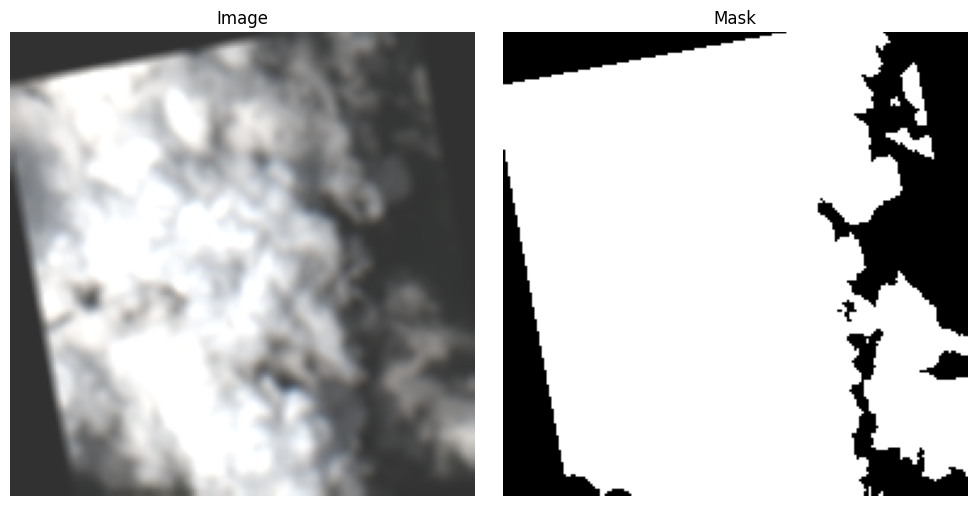

img shape:  torch.Size([4, 192, 192])
mask shape:  torch.Size([192, 192])
0.0 0.9450946
0 1 [0 1]


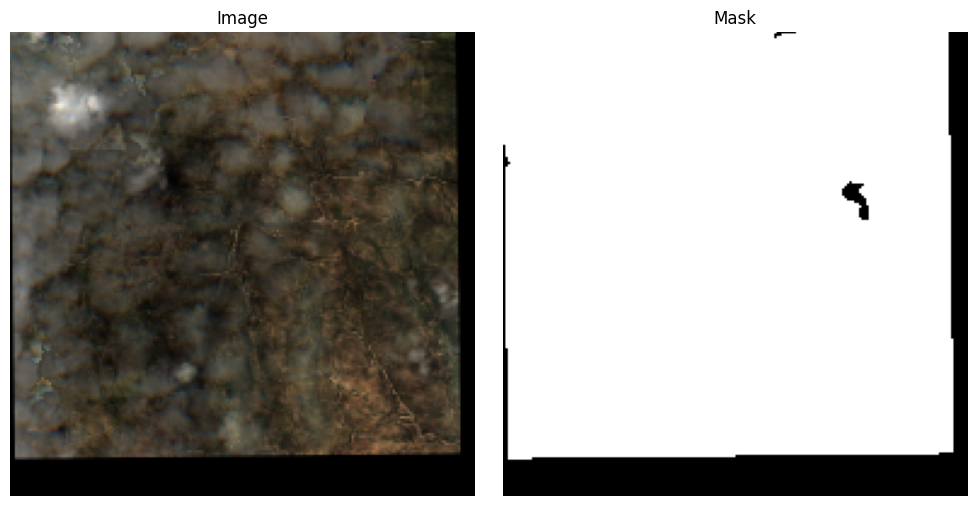

img shape:  torch.Size([4, 192, 192])
mask shape:  torch.Size([192, 192])
0.0 0.9853851
0 1 [0 1]


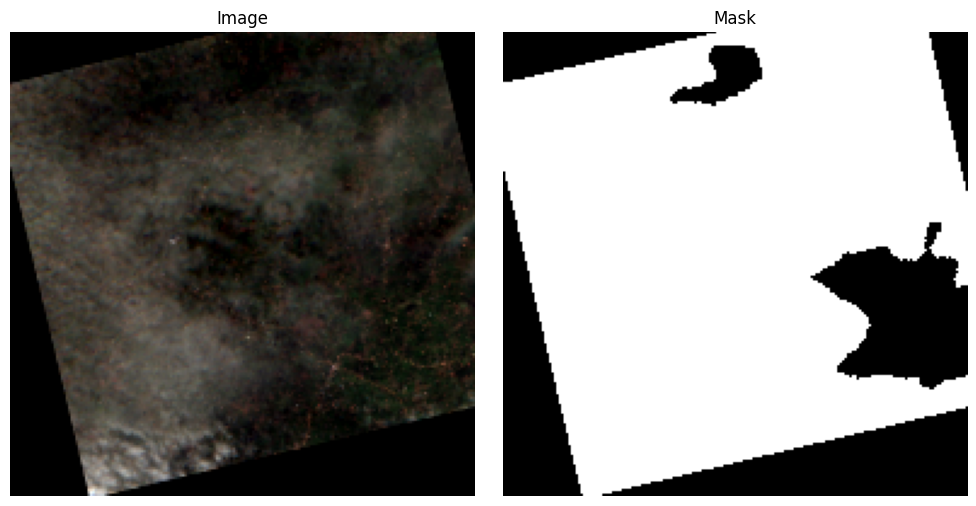

img shape:  torch.Size([4, 192, 192])
mask shape:  torch.Size([192, 192])
0.0 0.9746846
0 1 [0 1]


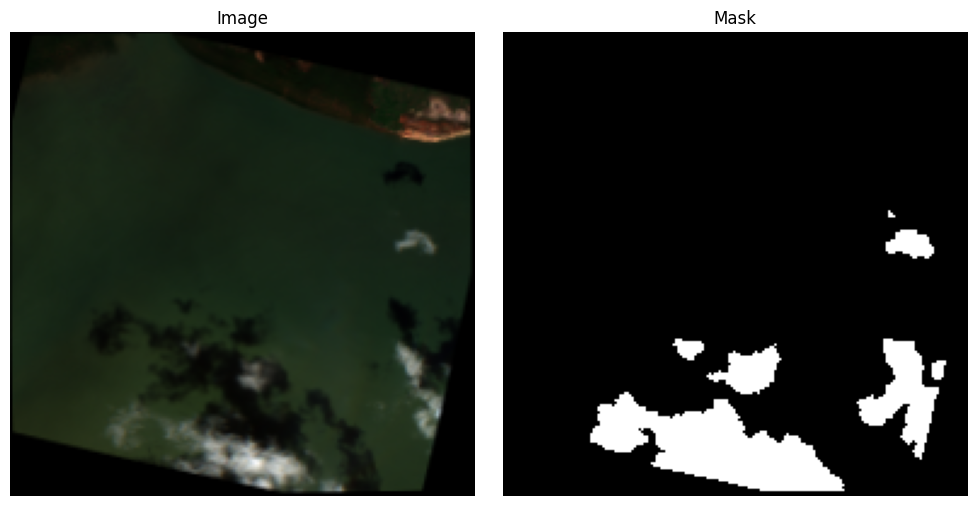

img shape:  torch.Size([4, 192, 192])
mask shape:  torch.Size([192, 192])
0.00011292417 1.0
0 1 [0 1]


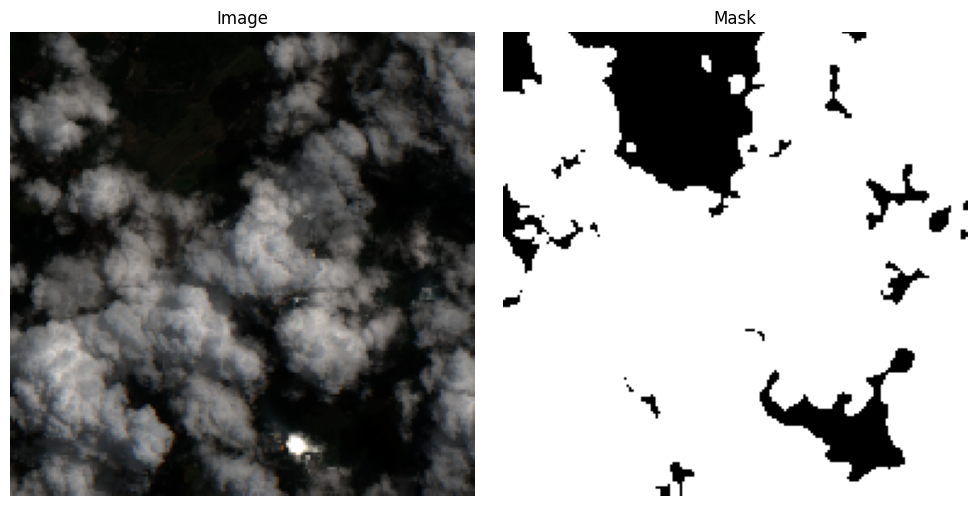

img shape:  torch.Size([4, 192, 192])
mask shape:  torch.Size([192, 192])
0.0 1.0
0 1 [0 1]


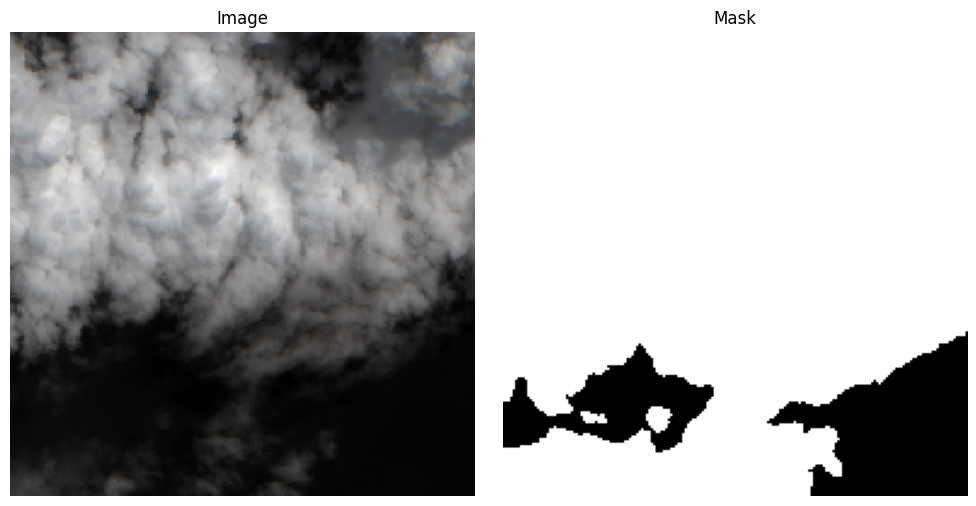

img shape:  torch.Size([4, 192, 192])
mask shape:  torch.Size([192, 192])
0.0 0.99101526
0 1 [0 1]


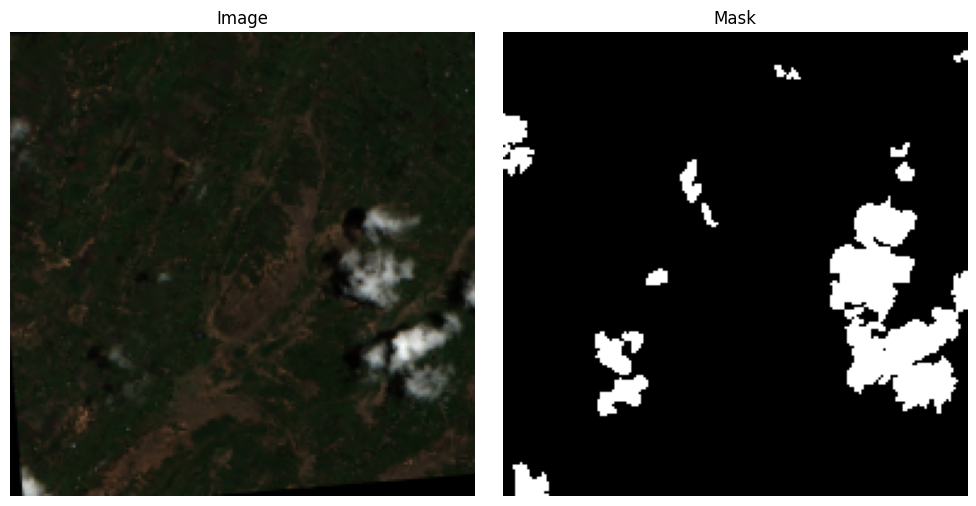

In [8]:
import matplotlib.pyplot as plt
import numpy as np
import random

def visualize_sample(dataset, idx=None, rgb_indices=(2, 1, 0)):  # Default: BGR -> RGB
    if idx is None:
        idx = random.randint(0, len(dataset) - 1)
        
    image, mask = dataset[idx]  # image: Tensor (C, H, W), mask: Tensor (H, W)
    print("img shape: ", image.shape)
    print("mask shape: ", mask.shape)
    image_np = image.permute(1, 2, 0).cpu().numpy()  # (H, W, C)
    mask_np = mask.cpu().numpy()
    print(image_np.min(), image_np.max())
    print(mask_np.min(), mask_np.max(), np.unique(mask_np))

    # Normalize for RGB display
    if image_np.shape[-1] >= 3:
        rgb = image_np[..., list(rgb_indices)]
        rgb = np.clip(rgb, 0, 1)
    else:
        rgb = image_np[..., 0]

    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(rgb)
    axs[0].set_title("Image")
    axs[0].axis("off")

    axs[1].imshow(mask_np, cmap="gray")
    axs[1].set_title("Mask")
    axs[1].axis("off")

    plt.tight_layout()
    plt.show()

# Uncomment for visualizations
for _ in range(7):
    visualize_sample(CloudDataset(train_imgs, train_masks, train_transform))

In [9]:
batch_size = 16

train_dataset = CloudDataset(train_imgs, train_masks, train_transform)
val_dataset = CloudDataset(val_imgs, val_masks, val_transform)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

In [10]:
def compute_iou(preds, targets, threshold=0.5, eps=1e-6):
    preds = torch.sigmoid(preds) > threshold  # convert logits to binary mask
    preds = preds.int()
    targets = targets.int()

    intersection = (preds & targets).float().sum((1, 2, 3))
    union = (preds | targets).float().sum((1, 2, 3))

    iou = (intersection + eps) / (union + eps)
    return iou.mean().item()  # mIoU over batch


In [11]:
class DiceLoss(nn.Module):
    def __init__(self, smooth=1.0):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, preds, targets):
        preds = torch.sigmoid(preds)  # Ensure preds are in [0, 1]
        preds = preds.view(-1)
        targets = targets.view(-1)

        intersection = (preds * targets).sum()
        dice_score = (2. * intersection + self.smooth) / (preds.sum() + targets.sum() + self.smooth)

        return 1 - dice_score

In [12]:
def visualize_predictions(model, dataloader, device, num_samples=3, threshold=0.5):
    model.eval()
    images, masks = next(iter(dataloader))
    images = images.to(device)
    masks = masks.to(device).unsqueeze(1).float()

    with torch.no_grad():
        preds = torch.sigmoid(model(images))
        preds = (preds > threshold).float()

    for i in range(min(num_samples, images.size(0))):
        img = images[i].permute(1, 2, 0).cpu().numpy()
        mask_true = masks[i, 0].cpu().numpy()
        mask_pred = preds[i, 0].cpu().numpy()

        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        axs[0].imshow(np.clip(img, 0, 1))
        axs[0].set_title("Image")
        axs[1].imshow(mask_true, cmap='gray')
        axs[1].set_title("Ground Truth")
        axs[2].imshow(mask_pred, cmap='gray')
        axs[2].set_title("Prediction")
        for ax in axs: ax.axis('off')
        plt.tight_layout()
        plt.show()


In [13]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)
model = CloudNet(in_channels=4, out_channels=1).to(device)
bce_loss = nn.BCEWithLogitsLoss()
dice_loss = DiceLoss()
optimizer = optim.Adam(model.parameters(), lr=5e-4)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.7, patience=5)

cuda


100%|██████████| 47/47 [00:30<00:00,  1.52it/s]


Epoch 1 | Learning rate: 0.000500
Epoch [1/100], Train Loss: 0.3090, Val Loss: 0.2648, Val Bloss: 0.2955, Val Dloss: 0.1933, Val mIoU: 0.6656
Best model saved at epoch 1


100%|██████████| 47/47 [00:11<00:00,  4.06it/s]


Epoch 2 | Learning rate: 0.000500
Epoch [2/100], Train Loss: 0.2482, Val Loss: 0.2318, Val Bloss: 0.2682, Val Dloss: 0.1469, Val mIoU: 0.7379
Best model saved at epoch 2


100%|██████████| 47/47 [00:11<00:00,  4.05it/s]


Epoch 3 | Learning rate: 0.000500
Epoch [3/100], Train Loss: 0.2242, Val Loss: 0.1894, Val Bloss: 0.2161, Val Dloss: 0.1272, Val mIoU: 0.7647
Best model saved at epoch 3


100%|██████████| 47/47 [00:11<00:00,  4.19it/s]


Epoch 4 | Learning rate: 0.000500
Epoch [4/100], Train Loss: 0.2155, Val Loss: 0.1685, Val Bloss: 0.1927, Val Dloss: 0.1121, Val mIoU: 0.7867
Best model saved at epoch 4


100%|██████████| 47/47 [00:11<00:00,  4.22it/s]


Epoch 5 | Learning rate: 0.000500
Epoch [5/100], Train Loss: 0.2026, Val Loss: 0.1704, Val Bloss: 0.1946, Val Dloss: 0.1141, Val mIoU: 0.7726


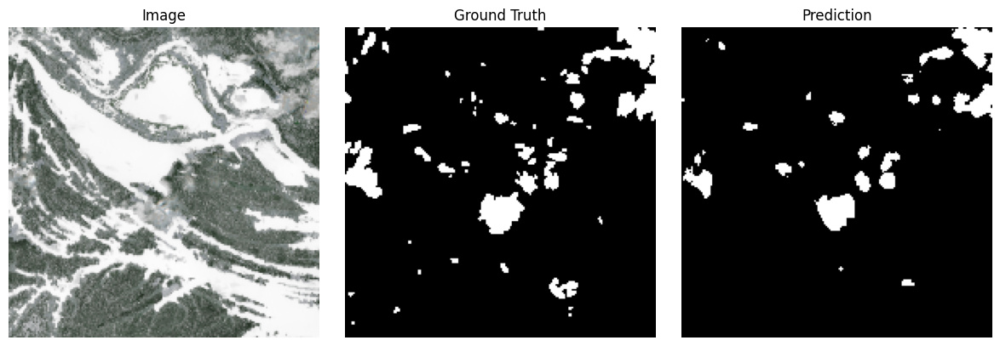

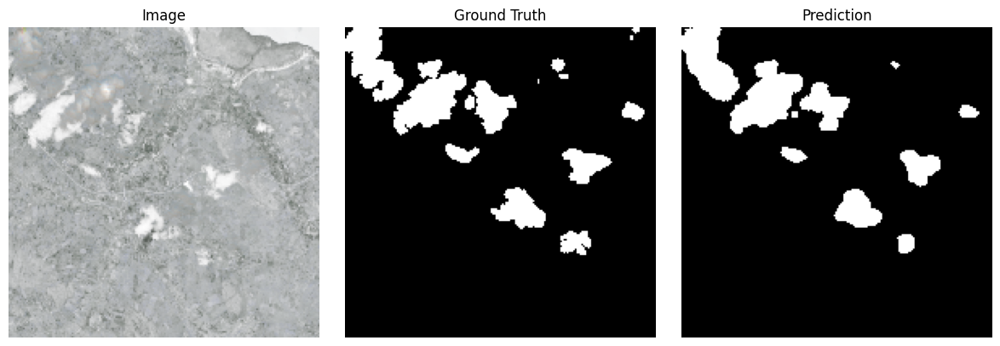

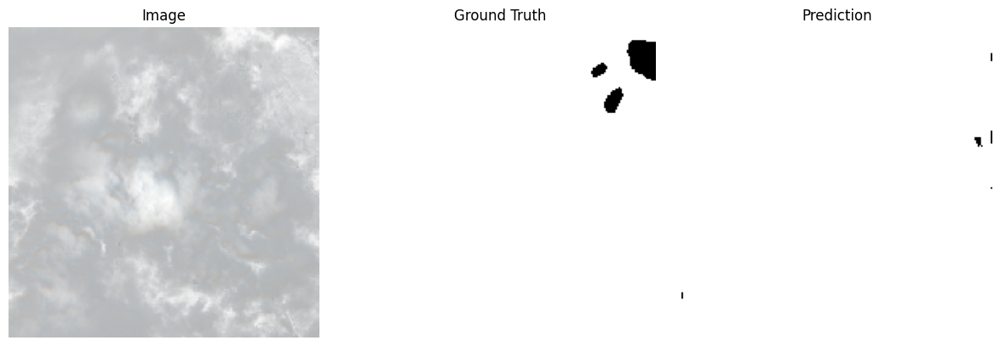

100%|██████████| 47/47 [00:11<00:00,  4.18it/s]


Epoch 6 | Learning rate: 0.000500
Epoch [6/100], Train Loss: 0.1994, Val Loss: 0.1709, Val Bloss: 0.1945, Val Dloss: 0.1156, Val mIoU: 0.7832


100%|██████████| 47/47 [00:11<00:00,  4.10it/s]


Epoch 7 | Learning rate: 0.000500
Epoch [7/100], Train Loss: 0.1866, Val Loss: 0.1746, Val Bloss: 0.2032, Val Dloss: 0.1080, Val mIoU: 0.7870


100%|██████████| 47/47 [00:11<00:00,  4.07it/s]


Epoch 8 | Learning rate: 0.000500
Epoch [8/100], Train Loss: 0.1883, Val Loss: 0.1574, Val Bloss: 0.1857, Val Dloss: 0.0916, Val mIoU: 0.8103
Best model saved at epoch 8


100%|██████████| 47/47 [00:11<00:00,  4.13it/s]


Epoch 9 | Learning rate: 0.000500
Epoch [9/100], Train Loss: 0.1842, Val Loss: 0.1636, Val Bloss: 0.1895, Val Dloss: 0.1030, Val mIoU: 0.8020


100%|██████████| 47/47 [00:11<00:00,  4.08it/s]


Epoch 10 | Learning rate: 0.000500
Epoch [10/100], Train Loss: 0.1770, Val Loss: 0.1687, Val Bloss: 0.1930, Val Dloss: 0.1119, Val mIoU: 0.8045


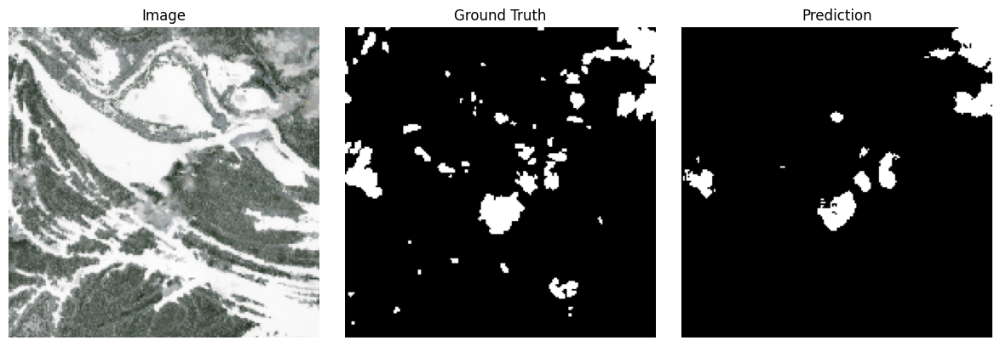

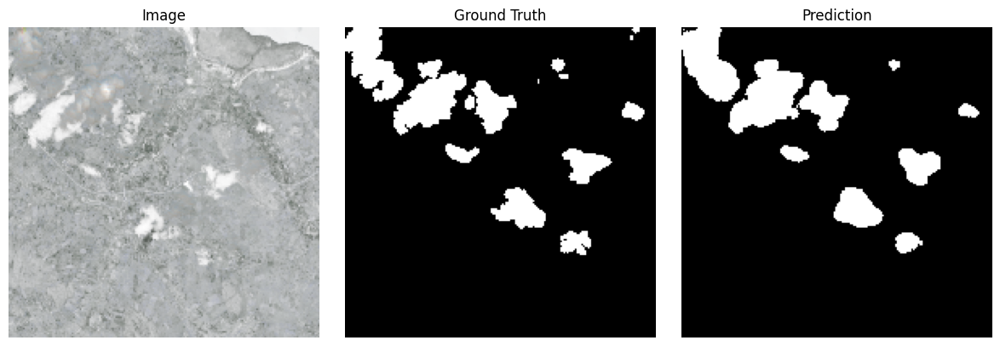

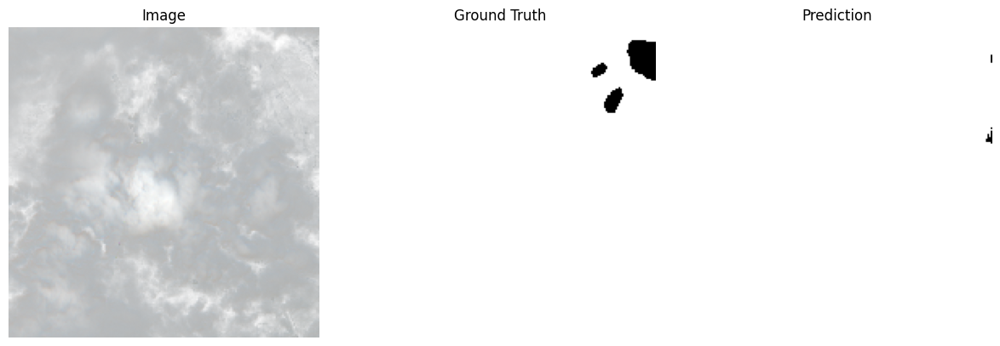

100%|██████████| 47/47 [00:11<00:00,  4.17it/s]


Epoch 11 | Learning rate: 0.000500
Epoch [11/100], Train Loss: 0.1745, Val Loss: 0.1608, Val Bloss: 0.1904, Val Dloss: 0.0918, Val mIoU: 0.8147


100%|██████████| 47/47 [00:11<00:00,  4.09it/s]


Epoch 12 | Learning rate: 0.000500
Epoch [12/100], Train Loss: 0.1726, Val Loss: 0.1505, Val Bloss: 0.1746, Val Dloss: 0.0945, Val mIoU: 0.8060
Best model saved at epoch 12


100%|██████████| 47/47 [00:11<00:00,  4.17it/s]


Epoch 13 | Learning rate: 0.000500
Epoch [13/100], Train Loss: 0.1694, Val Loss: 0.1898, Val Bloss: 0.2165, Val Dloss: 0.1274, Val mIoU: 0.7828


100%|██████████| 47/47 [00:11<00:00,  4.21it/s]


Epoch 14 | Learning rate: 0.000500
Epoch [14/100], Train Loss: 0.1706, Val Loss: 0.1571, Val Bloss: 0.1826, Val Dloss: 0.0977, Val mIoU: 0.8131


100%|██████████| 47/47 [00:11<00:00,  4.23it/s]


Epoch 15 | Learning rate: 0.000500
Epoch [15/100], Train Loss: 0.1673, Val Loss: 0.1574, Val Bloss: 0.1809, Val Dloss: 0.1026, Val mIoU: 0.8003


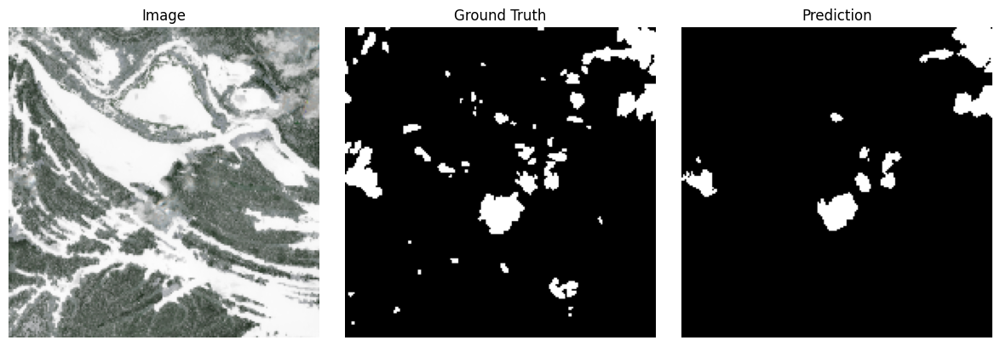

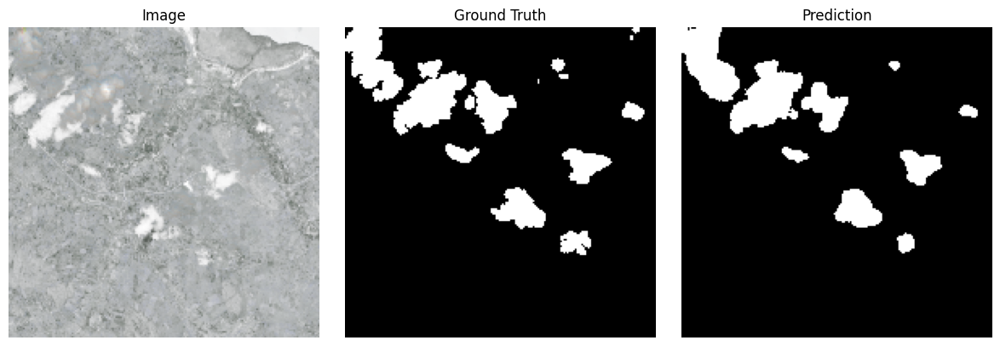

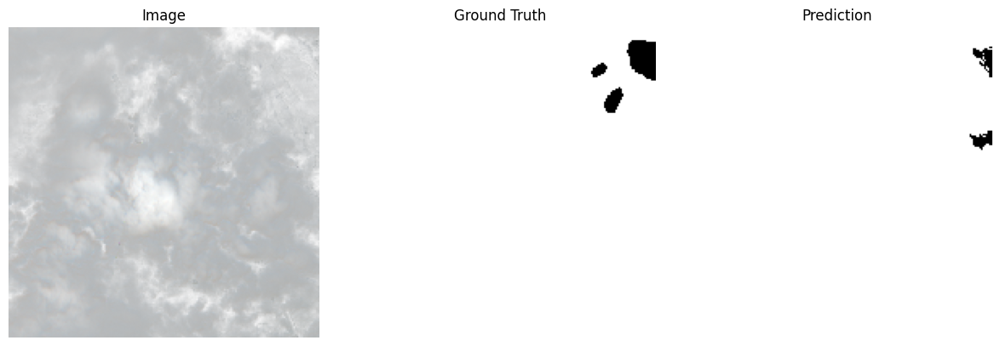

100%|██████████| 47/47 [00:11<00:00,  4.08it/s]


Epoch 16 | Learning rate: 0.000500
Epoch [16/100], Train Loss: 0.1710, Val Loss: 0.1645, Val Bloss: 0.1905, Val Dloss: 0.1038, Val mIoU: 0.8083


100%|██████████| 47/47 [00:11<00:00,  4.06it/s]


Epoch 17 | Learning rate: 0.000500
Epoch [17/100], Train Loss: 0.1658, Val Loss: 0.1456, Val Bloss: 0.1685, Val Dloss: 0.0921, Val mIoU: 0.8024
Best model saved at epoch 17


100%|██████████| 47/47 [00:11<00:00,  4.13it/s]


Epoch 18 | Learning rate: 0.000500
Epoch [18/100], Train Loss: 0.1660, Val Loss: 0.1510, Val Bloss: 0.1752, Val Dloss: 0.0947, Val mIoU: 0.8188


100%|██████████| 47/47 [00:11<00:00,  4.20it/s]


Epoch 19 | Learning rate: 0.000500
Epoch [19/100], Train Loss: 0.1617, Val Loss: 0.1463, Val Bloss: 0.1654, Val Dloss: 0.1015, Val mIoU: 0.8196


100%|██████████| 47/47 [00:11<00:00,  4.16it/s]


Epoch 20 | Learning rate: 0.000500
Epoch [20/100], Train Loss: 0.1580, Val Loss: 0.1398, Val Bloss: 0.1609, Val Dloss: 0.0907, Val mIoU: 0.8131


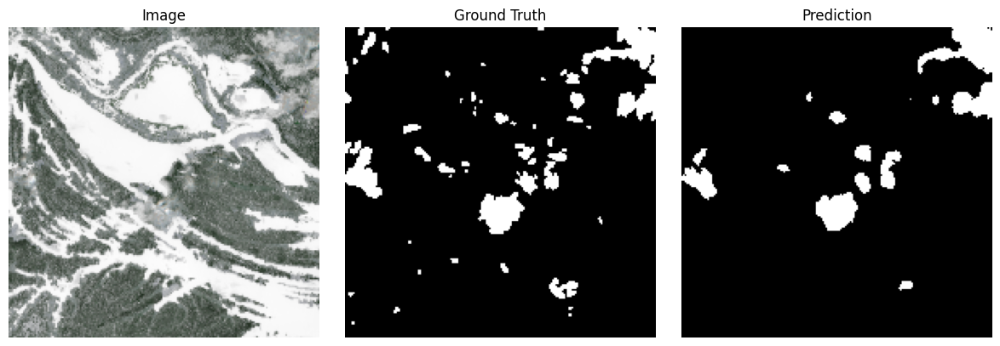

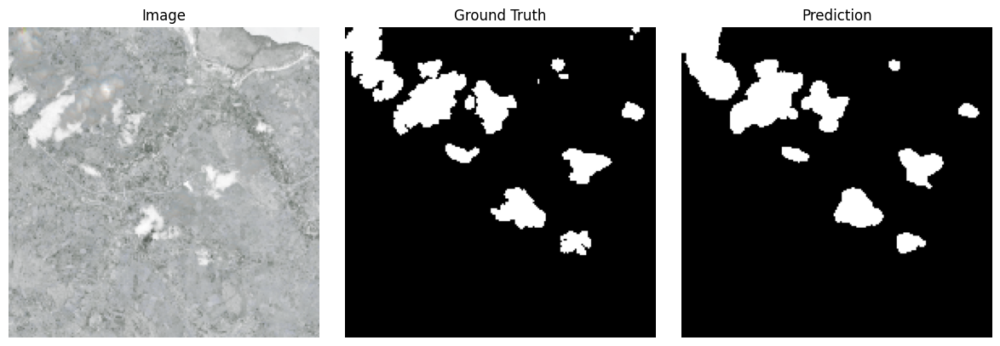

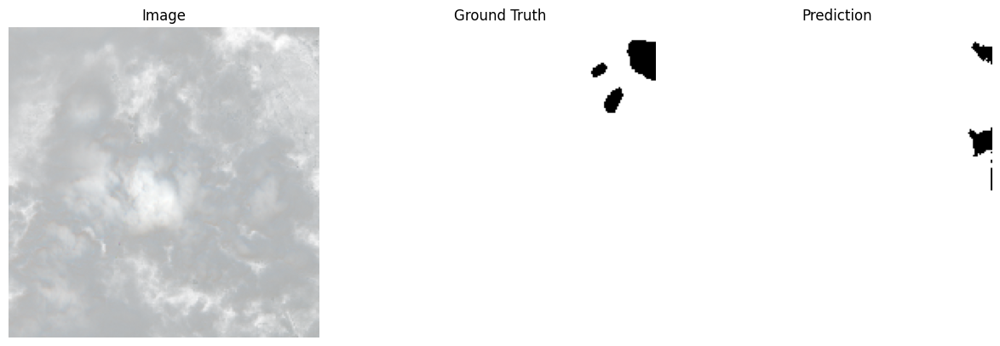

Best model saved at epoch 20


100%|██████████| 47/47 [00:11<00:00,  3.99it/s]


Epoch 21 | Learning rate: 0.000500
Epoch [21/100], Train Loss: 0.1600, Val Loss: 0.1408, Val Bloss: 0.1614, Val Dloss: 0.0926, Val mIoU: 0.8140


100%|██████████| 47/47 [00:11<00:00,  4.08it/s]


Epoch 22 | Learning rate: 0.000500
Epoch [22/100], Train Loss: 0.1580, Val Loss: 0.1471, Val Bloss: 0.1664, Val Dloss: 0.1020, Val mIoU: 0.8108


100%|██████████| 47/47 [00:11<00:00,  4.16it/s]


Epoch 23 | Learning rate: 0.000500
Epoch [23/100], Train Loss: 0.1600, Val Loss: 0.1398, Val Bloss: 0.1636, Val Dloss: 0.0842, Val mIoU: 0.8141
Best model saved at epoch 23


100%|██████████| 47/47 [00:11<00:00,  4.18it/s]


Epoch 24 | Learning rate: 0.000500
Epoch [24/100], Train Loss: 0.1574, Val Loss: 0.1445, Val Bloss: 0.1653, Val Dloss: 0.0961, Val mIoU: 0.8188


100%|██████████| 47/47 [00:11<00:00,  4.03it/s]


Epoch 25 | Learning rate: 0.000500
Epoch [25/100], Train Loss: 0.1577, Val Loss: 0.1485, Val Bloss: 0.1719, Val Dloss: 0.0937, Val mIoU: 0.8085


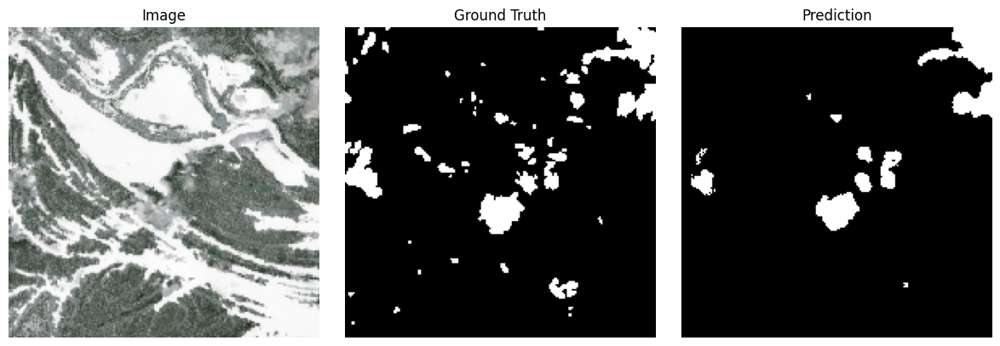

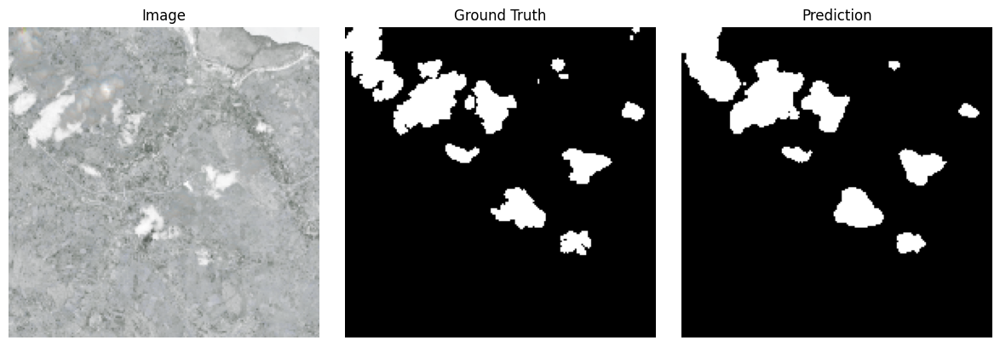

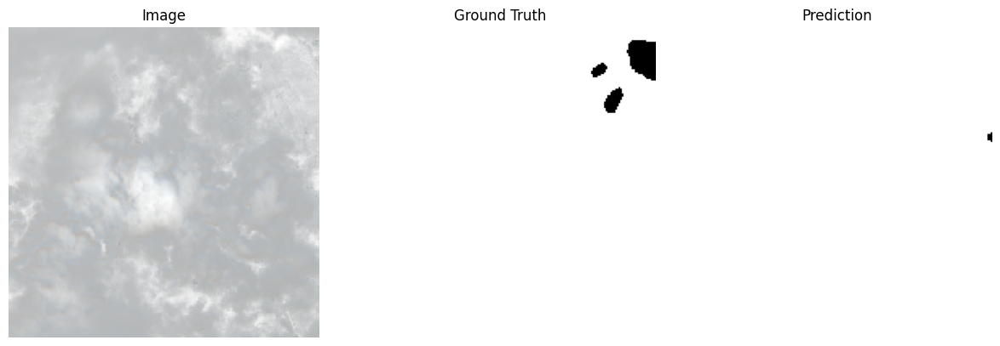

100%|██████████| 47/47 [00:11<00:00,  4.10it/s]


Epoch 26 | Learning rate: 0.000500
Epoch [26/100], Train Loss: 0.1555, Val Loss: 0.1347, Val Bloss: 0.1539, Val Dloss: 0.0897, Val mIoU: 0.8212
Best model saved at epoch 26


100%|██████████| 47/47 [00:11<00:00,  4.16it/s]


Epoch 27 | Learning rate: 0.000500
Epoch [27/100], Train Loss: 0.1541, Val Loss: 0.1424, Val Bloss: 0.1656, Val Dloss: 0.0884, Val mIoU: 0.8248


100%|██████████| 47/47 [00:11<00:00,  4.21it/s]


Epoch 28 | Learning rate: 0.000500
Epoch [28/100], Train Loss: 0.1531, Val Loss: 0.1460, Val Bloss: 0.1695, Val Dloss: 0.0911, Val mIoU: 0.8234


100%|██████████| 47/47 [00:11<00:00,  4.23it/s]


Epoch 29 | Learning rate: 0.000500
Epoch [29/100], Train Loss: 0.1553, Val Loss: 0.1426, Val Bloss: 0.1649, Val Dloss: 0.0905, Val mIoU: 0.8184


100%|██████████| 47/47 [00:11<00:00,  4.17it/s]


Epoch 30 | Learning rate: 0.000500
Epoch [30/100], Train Loss: 0.1524, Val Loss: 0.1377, Val Bloss: 0.1593, Val Dloss: 0.0872, Val mIoU: 0.8233


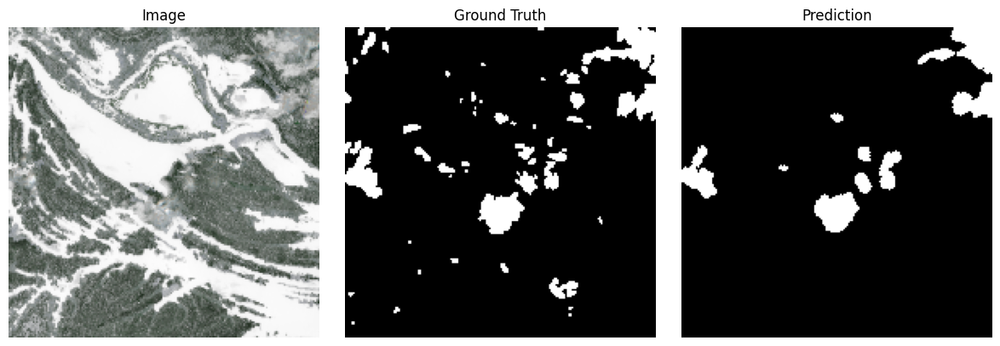

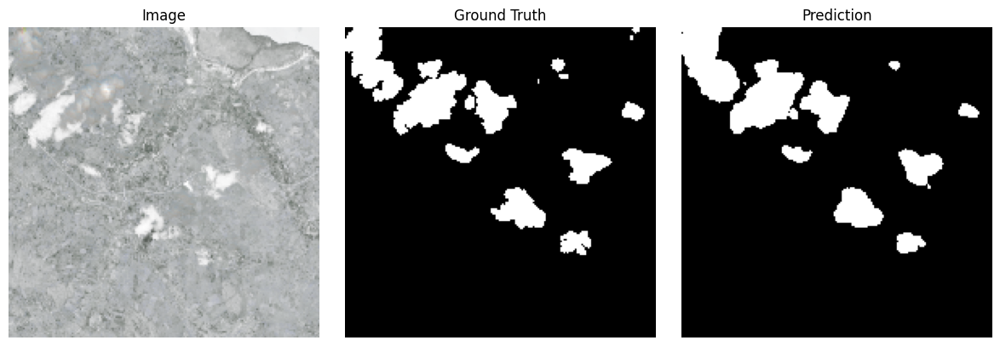

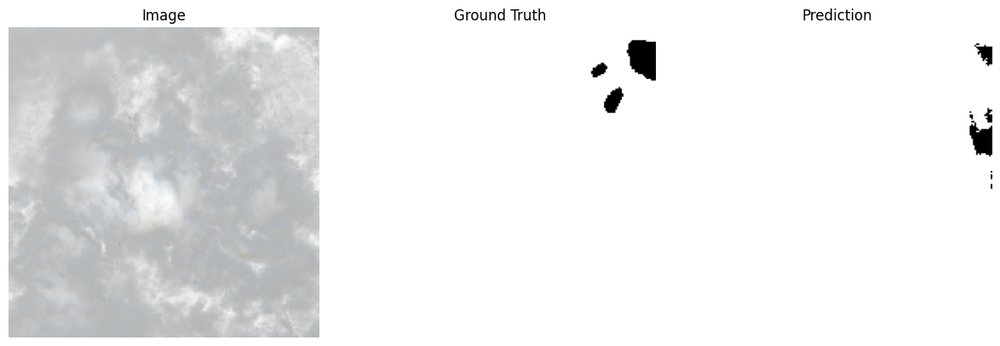

100%|██████████| 47/47 [00:11<00:00,  4.19it/s]


Epoch 31 | Learning rate: 0.000500
Epoch [31/100], Train Loss: 0.1507, Val Loss: 0.1418, Val Bloss: 0.1631, Val Dloss: 0.0920, Val mIoU: 0.8209


100%|██████████| 47/47 [00:11<00:00,  4.11it/s]


Epoch 32 | Learning rate: 0.000350
Epoch [32/100], Train Loss: 0.1524, Val Loss: 0.1451, Val Bloss: 0.1661, Val Dloss: 0.0960, Val mIoU: 0.8197


100%|██████████| 47/47 [00:11<00:00,  4.16it/s]


Epoch 33 | Learning rate: 0.000350
Epoch [33/100], Train Loss: 0.1476, Val Loss: 0.1364, Val Bloss: 0.1592, Val Dloss: 0.0832, Val mIoU: 0.8226


100%|██████████| 47/47 [00:11<00:00,  4.20it/s]


Epoch 34 | Learning rate: 0.000350
Epoch [34/100], Train Loss: 0.1457, Val Loss: 0.1357, Val Bloss: 0.1582, Val Dloss: 0.0833, Val mIoU: 0.8323


100%|██████████| 47/47 [00:11<00:00,  4.20it/s]


Epoch 35 | Learning rate: 0.000350
Epoch [35/100], Train Loss: 0.1445, Val Loss: 0.1349, Val Bloss: 0.1579, Val Dloss: 0.0812, Val mIoU: 0.8327


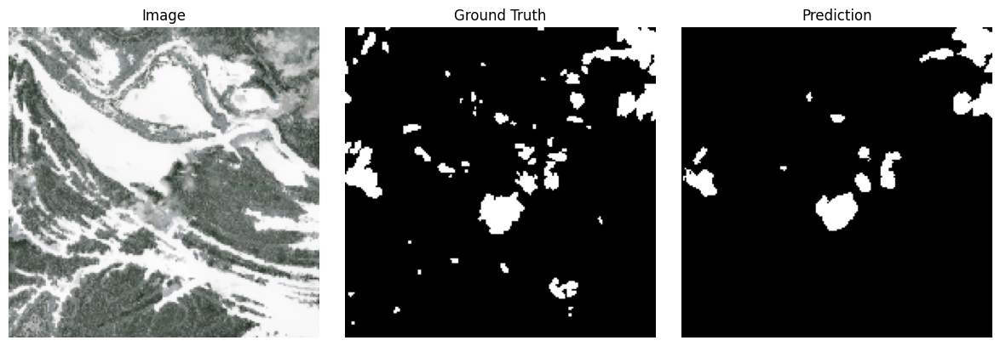

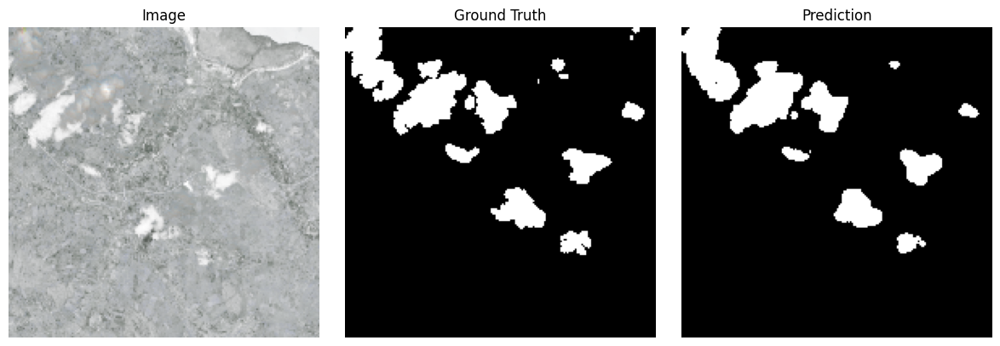

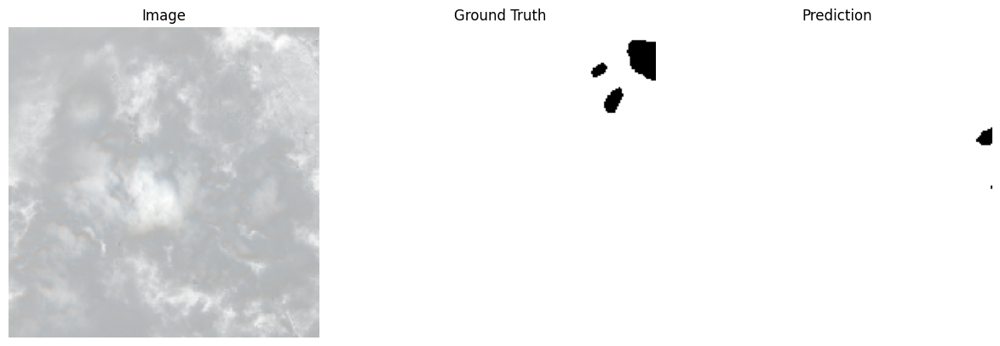

100%|██████████| 47/47 [00:11<00:00,  4.19it/s]


Epoch 36 | Learning rate: 0.000350
Epoch [36/100], Train Loss: 0.1453, Val Loss: 0.1387, Val Bloss: 0.1612, Val Dloss: 0.0863, Val mIoU: 0.8188


100%|██████████| 47/47 [00:11<00:00,  4.18it/s]


Epoch 37 | Learning rate: 0.000350
Epoch [37/100], Train Loss: 0.1457, Val Loss: 0.1384, Val Bloss: 0.1604, Val Dloss: 0.0870, Val mIoU: 0.8287


100%|██████████| 47/47 [00:11<00:00,  4.11it/s]


Epoch 38 | Learning rate: 0.000245
Epoch [38/100], Train Loss: 0.1446, Val Loss: 0.1418, Val Bloss: 0.1656, Val Dloss: 0.0862, Val mIoU: 0.8262


100%|██████████| 47/47 [00:11<00:00,  4.20it/s]


Epoch 39 | Learning rate: 0.000245
Epoch [39/100], Train Loss: 0.1428, Val Loss: 0.1325, Val Bloss: 0.1536, Val Dloss: 0.0834, Val mIoU: 0.8299
Best model saved at epoch 39


100%|██████████| 47/47 [00:11<00:00,  4.22it/s]


Epoch 40 | Learning rate: 0.000245
Epoch [40/100], Train Loss: 0.1420, Val Loss: 0.1318, Val Bloss: 0.1532, Val Dloss: 0.0818, Val mIoU: 0.8311


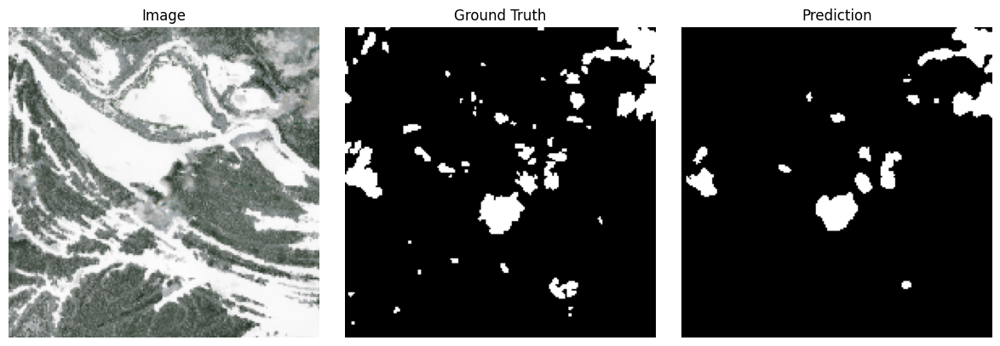

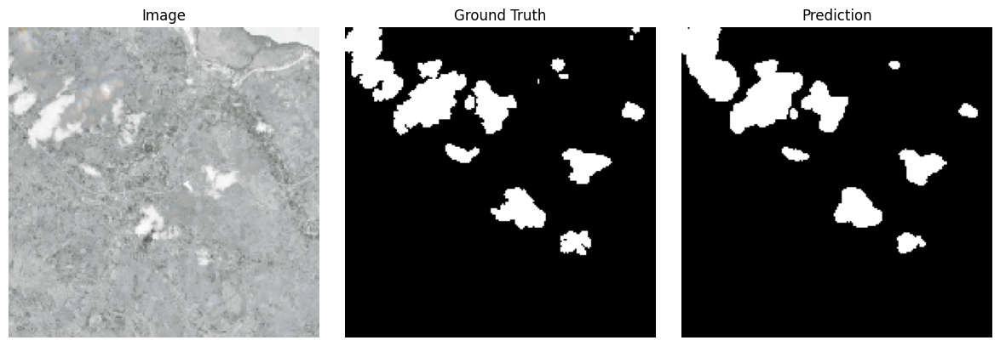

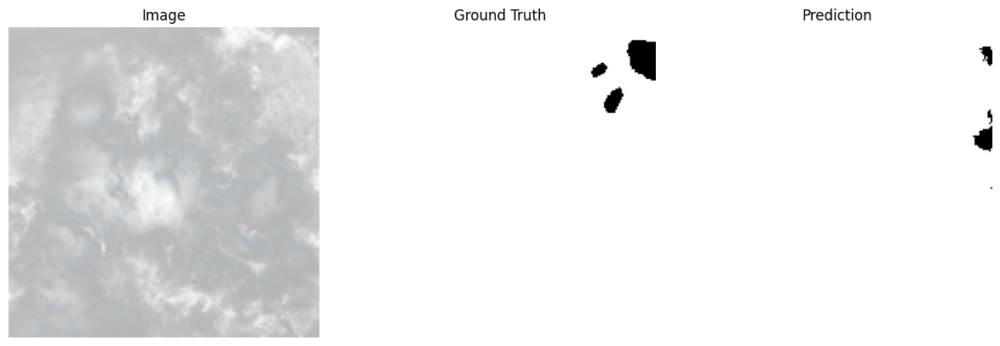

Best model saved at epoch 40


100%|██████████| 47/47 [00:11<00:00,  4.14it/s]


Epoch 41 | Learning rate: 0.000245
Epoch [41/100], Train Loss: 0.1400, Val Loss: 0.1332, Val Bloss: 0.1542, Val Dloss: 0.0842, Val mIoU: 0.8276


100%|██████████| 47/47 [00:11<00:00,  4.15it/s]


Epoch 42 | Learning rate: 0.000245
Epoch [42/100], Train Loss: 0.1411, Val Loss: 0.1325, Val Bloss: 0.1531, Val Dloss: 0.0844, Val mIoU: 0.8313


100%|██████████| 47/47 [00:11<00:00,  4.11it/s]


Epoch 43 | Learning rate: 0.000245
Epoch [43/100], Train Loss: 0.1396, Val Loss: 0.1311, Val Bloss: 0.1503, Val Dloss: 0.0864, Val mIoU: 0.8256
Best model saved at epoch 43


100%|██████████| 47/47 [00:11<00:00,  4.21it/s]


Epoch 44 | Learning rate: 0.000245
Epoch [44/100], Train Loss: 0.1382, Val Loss: 0.1309, Val Bloss: 0.1523, Val Dloss: 0.0810, Val mIoU: 0.8385
Best model saved at epoch 44


100%|██████████| 47/47 [00:11<00:00,  4.12it/s]


Epoch 45 | Learning rate: 0.000245
Epoch [45/100], Train Loss: 0.1394, Val Loss: 0.1279, Val Bloss: 0.1476, Val Dloss: 0.0820, Val mIoU: 0.8387


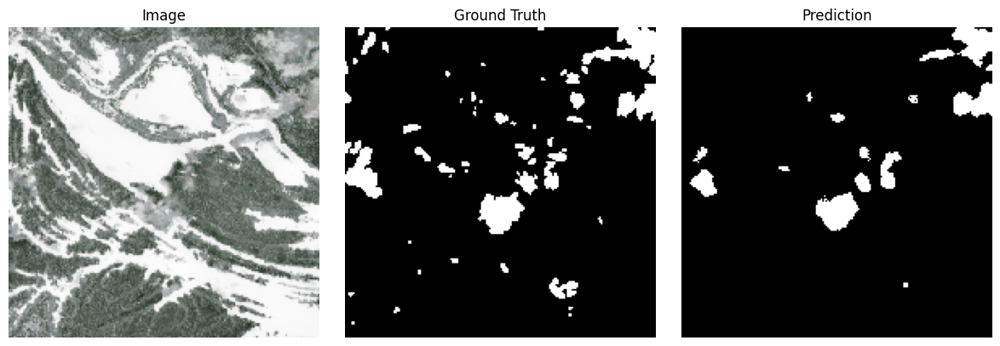

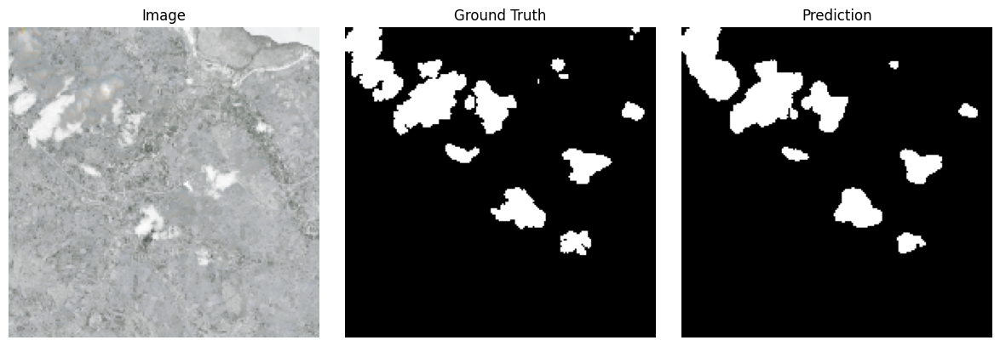

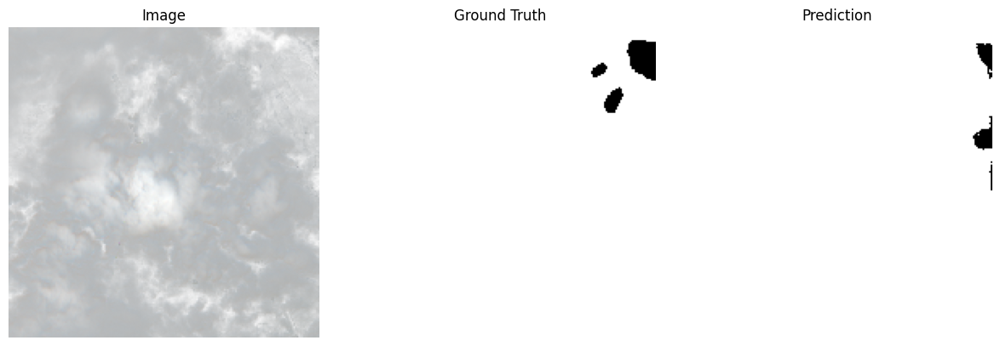

Best model saved at epoch 45


100%|██████████| 47/47 [00:12<00:00,  3.73it/s]


Epoch 46 | Learning rate: 0.000245
Epoch [46/100], Train Loss: 0.1384, Val Loss: 0.1303, Val Bloss: 0.1503, Val Dloss: 0.0835, Val mIoU: 0.8279


100%|██████████| 47/47 [00:11<00:00,  4.07it/s]


Epoch 47 | Learning rate: 0.000245
Epoch [47/100], Train Loss: 0.1387, Val Loss: 0.1354, Val Bloss: 0.1572, Val Dloss: 0.0846, Val mIoU: 0.8245


100%|██████████| 47/47 [00:11<00:00,  4.21it/s]


Epoch 48 | Learning rate: 0.000245
Epoch [48/100], Train Loss: 0.1383, Val Loss: 0.1348, Val Bloss: 0.1585, Val Dloss: 0.0795, Val mIoU: 0.8374


100%|██████████| 47/47 [00:11<00:00,  4.23it/s]


Epoch 49 | Learning rate: 0.000245
Epoch [49/100], Train Loss: 0.1392, Val Loss: 0.1348, Val Bloss: 0.1572, Val Dloss: 0.0826, Val mIoU: 0.8336


100%|██████████| 47/47 [00:11<00:00,  4.13it/s]


Epoch 50 | Learning rate: 0.000245
Epoch [50/100], Train Loss: 0.1395, Val Loss: 0.1308, Val Bloss: 0.1521, Val Dloss: 0.0809, Val mIoU: 0.8328


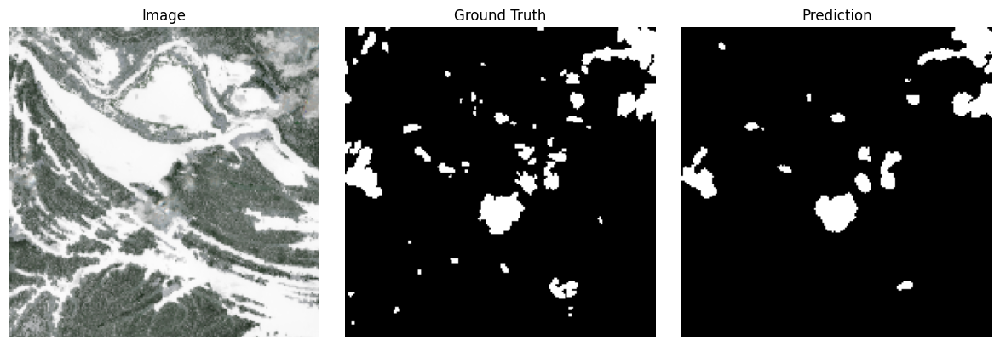

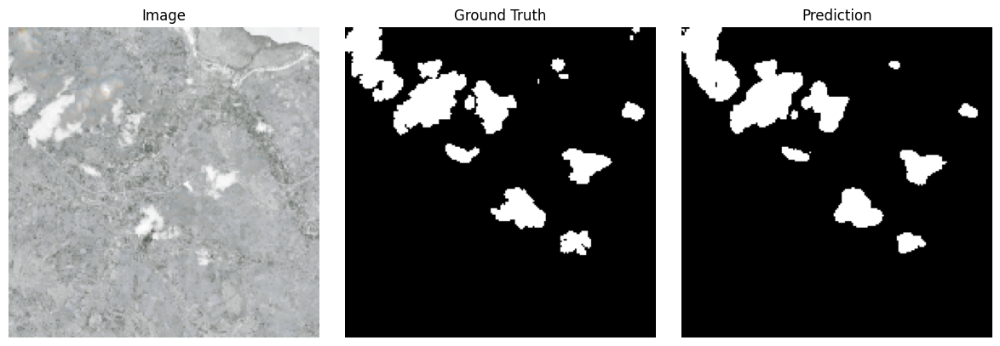

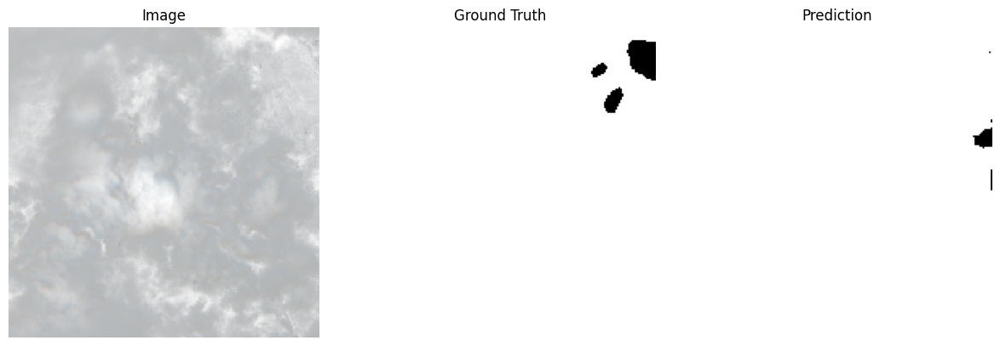

100%|██████████| 47/47 [00:11<00:00,  4.18it/s]


Epoch 51 | Learning rate: 0.000171
Epoch [51/100], Train Loss: 0.1369, Val Loss: 0.1298, Val Bloss: 0.1497, Val Dloss: 0.0832, Val mIoU: 0.8362


100%|██████████| 47/47 [00:11<00:00,  4.14it/s]


Epoch 52 | Learning rate: 0.000171
Epoch [52/100], Train Loss: 0.1357, Val Loss: 0.1314, Val Bloss: 0.1528, Val Dloss: 0.0813, Val mIoU: 0.8368


100%|██████████| 47/47 [00:11<00:00,  4.10it/s]


Epoch 53 | Learning rate: 0.000171
Epoch [53/100], Train Loss: 0.1358, Val Loss: 0.1285, Val Bloss: 0.1483, Val Dloss: 0.0822, Val mIoU: 0.8344


100%|██████████| 47/47 [00:11<00:00,  4.09it/s]


Epoch 54 | Learning rate: 0.000171
Epoch [54/100], Train Loss: 0.1334, Val Loss: 0.1292, Val Bloss: 0.1491, Val Dloss: 0.0829, Val mIoU: 0.8327


100%|██████████| 47/47 [00:11<00:00,  3.94it/s]


Epoch 55 | Learning rate: 0.000171
Epoch [55/100], Train Loss: 0.1351, Val Loss: 0.1303, Val Bloss: 0.1504, Val Dloss: 0.0833, Val mIoU: 0.8398


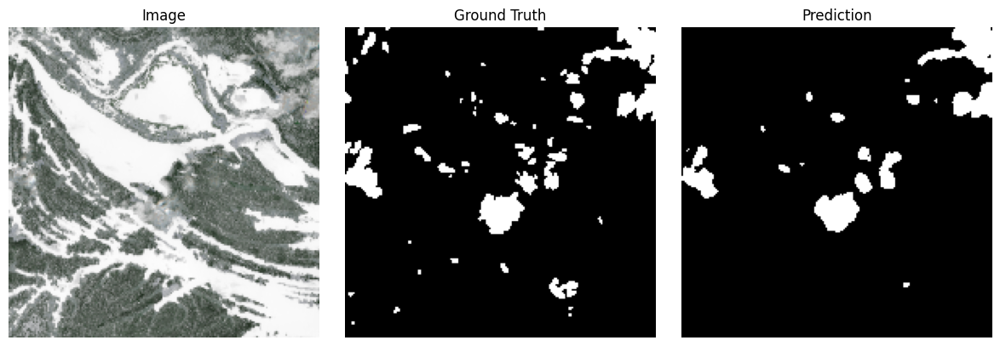

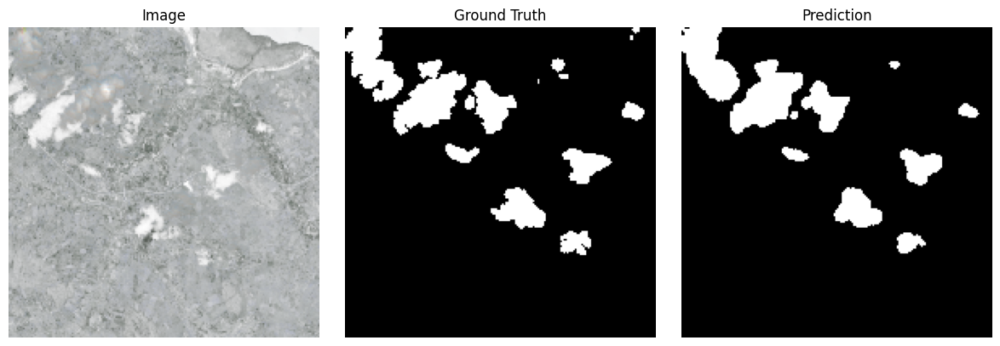

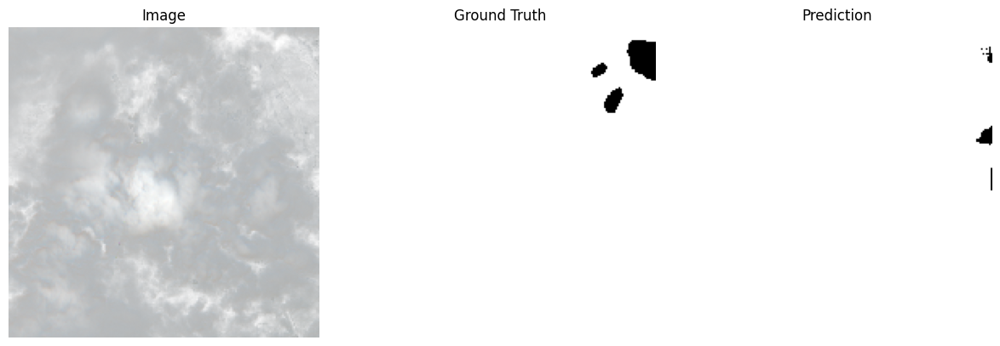

100%|██████████| 47/47 [00:11<00:00,  4.04it/s]


Epoch 56 | Learning rate: 0.000171
Epoch [56/100], Train Loss: 0.1353, Val Loss: 0.1292, Val Bloss: 0.1493, Val Dloss: 0.0823, Val mIoU: 0.8398


100%|██████████| 47/47 [00:11<00:00,  4.22it/s]


Epoch 57 | Learning rate: 0.000120
Epoch [57/100], Train Loss: 0.1344, Val Loss: 0.1320, Val Bloss: 0.1536, Val Dloss: 0.0816, Val mIoU: 0.8395


100%|██████████| 47/47 [00:11<00:00,  4.22it/s]


Epoch 58 | Learning rate: 0.000120
Epoch [58/100], Train Loss: 0.1327, Val Loss: 0.1280, Val Bloss: 0.1481, Val Dloss: 0.0811, Val mIoU: 0.8393


100%|██████████| 47/47 [00:11<00:00,  4.22it/s]


Epoch 59 | Learning rate: 0.000120
Epoch [59/100], Train Loss: 0.1311, Val Loss: 0.1266, Val Bloss: 0.1462, Val Dloss: 0.0808, Val mIoU: 0.8382
Best model saved at epoch 59


100%|██████████| 47/47 [00:11<00:00,  4.14it/s]


Epoch 60 | Learning rate: 0.000120
Epoch [60/100], Train Loss: 0.1306, Val Loss: 0.1293, Val Bloss: 0.1500, Val Dloss: 0.0811, Val mIoU: 0.8378


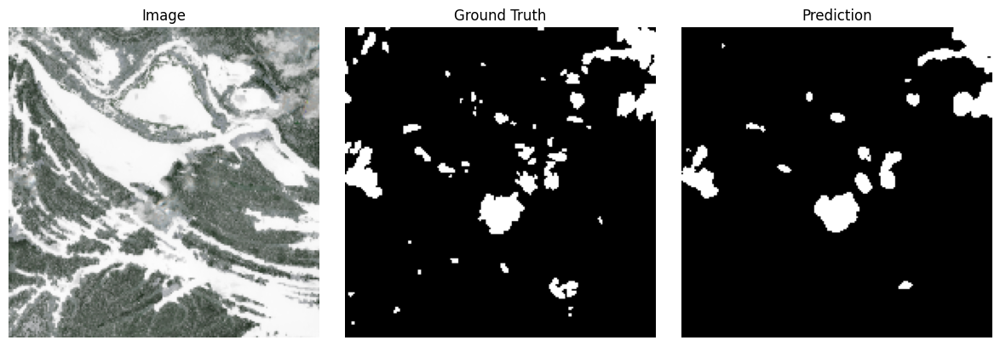

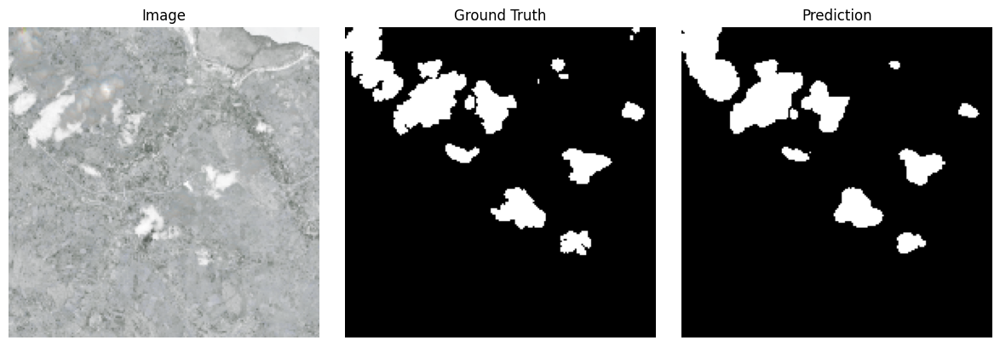

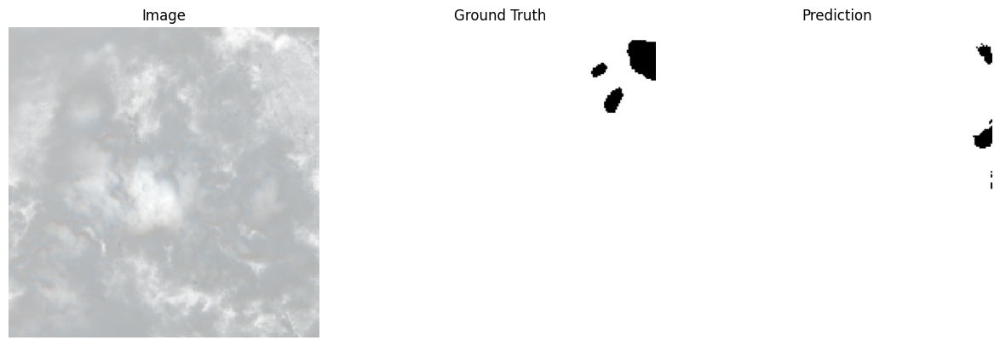

100%|██████████| 47/47 [00:11<00:00,  4.11it/s]


Epoch 61 | Learning rate: 0.000120
Epoch [61/100], Train Loss: 0.1323, Val Loss: 0.1274, Val Bloss: 0.1464, Val Dloss: 0.0830, Val mIoU: 0.8413


100%|██████████| 47/47 [00:11<00:00,  4.15it/s]


Epoch 62 | Learning rate: 0.000120
Epoch [62/100], Train Loss: 0.1313, Val Loss: 0.1266, Val Bloss: 0.1470, Val Dloss: 0.0788, Val mIoU: 0.8401
Best model saved at epoch 62


100%|██████████| 47/47 [00:11<00:00,  4.08it/s]


Epoch 63 | Learning rate: 0.000120
Epoch [63/100], Train Loss: 0.1314, Val Loss: 0.1302, Val Bloss: 0.1518, Val Dloss: 0.0799, Val mIoU: 0.8415


100%|██████████| 47/47 [00:11<00:00,  4.22it/s]


Epoch 64 | Learning rate: 0.000120
Epoch [64/100], Train Loss: 0.1329, Val Loss: 0.1284, Val Bloss: 0.1488, Val Dloss: 0.0808, Val mIoU: 0.8418


100%|██████████| 47/47 [00:11<00:00,  4.01it/s]


Epoch 65 | Learning rate: 0.000120
Epoch [65/100], Train Loss: 0.1305, Val Loss: 0.1269, Val Bloss: 0.1471, Val Dloss: 0.0797, Val mIoU: 0.8441


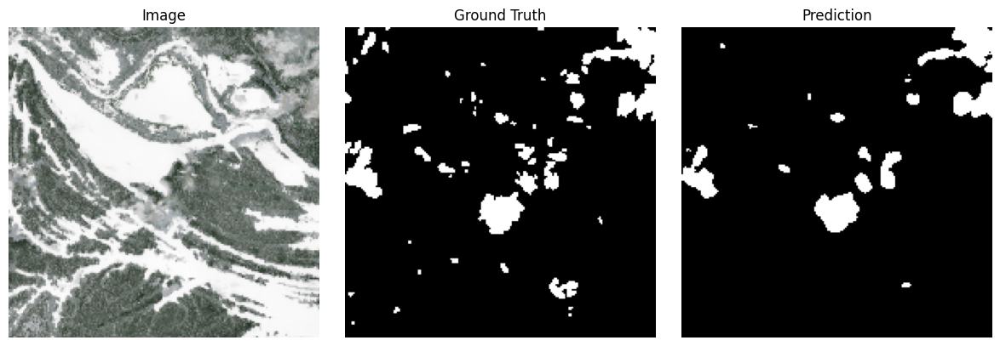

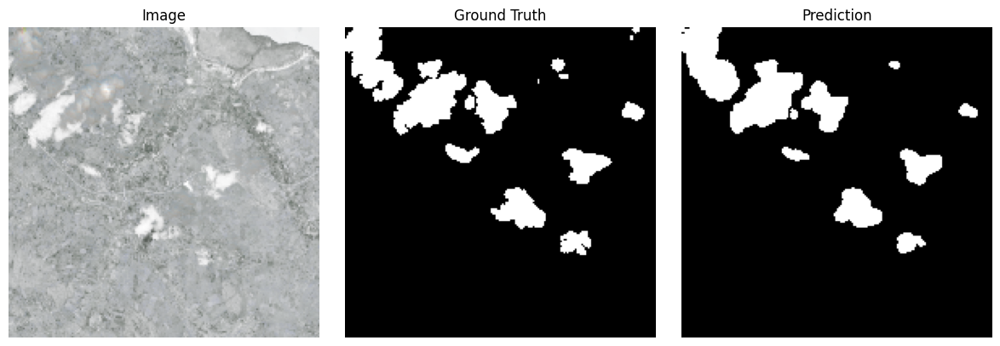

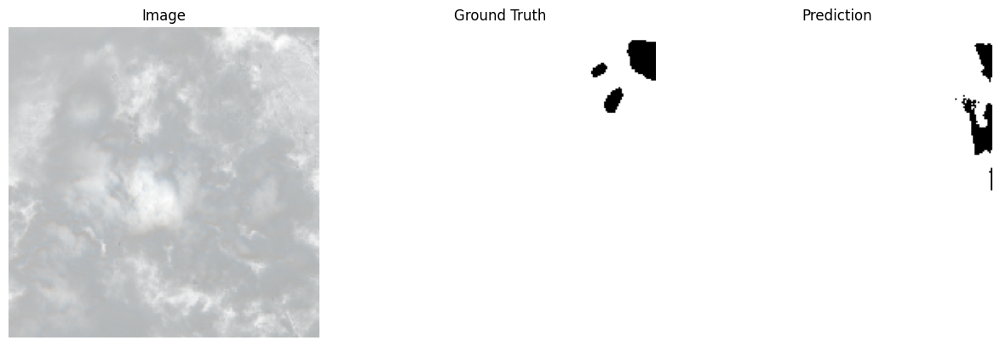

100%|██████████| 47/47 [00:11<00:00,  3.97it/s]


Epoch 66 | Learning rate: 0.000120
Epoch [66/100], Train Loss: 0.1308, Val Loss: 0.1280, Val Bloss: 0.1485, Val Dloss: 0.0803, Val mIoU: 0.8422


100%|██████████| 47/47 [00:11<00:00,  4.19it/s]


Epoch 67 | Learning rate: 0.000120
Epoch [67/100], Train Loss: 0.1318, Val Loss: 0.1310, Val Bloss: 0.1518, Val Dloss: 0.0824, Val mIoU: 0.8391


100%|██████████| 47/47 [00:11<00:00,  4.12it/s]


Epoch 68 | Learning rate: 0.000084
Epoch [68/100], Train Loss: 0.1310, Val Loss: 0.1270, Val Bloss: 0.1470, Val Dloss: 0.0802, Val mIoU: 0.8426


100%|██████████| 47/47 [00:11<00:00,  4.09it/s]


Epoch 69 | Learning rate: 0.000084
Epoch [69/100], Train Loss: 0.1297, Val Loss: 0.1261, Val Bloss: 0.1461, Val Dloss: 0.0795, Val mIoU: 0.8428
Best model saved at epoch 69


100%|██████████| 47/47 [00:11<00:00,  4.10it/s]


Epoch 70 | Learning rate: 0.000084
Epoch [70/100], Train Loss: 0.1281, Val Loss: 0.1292, Val Bloss: 0.1510, Val Dloss: 0.0783, Val mIoU: 0.8437


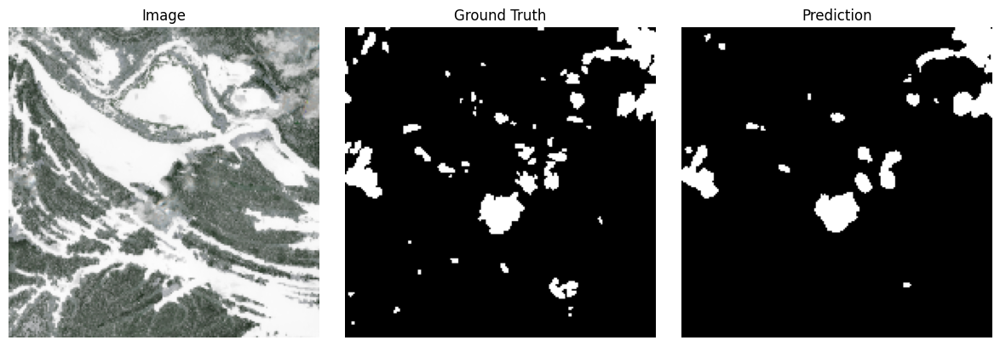

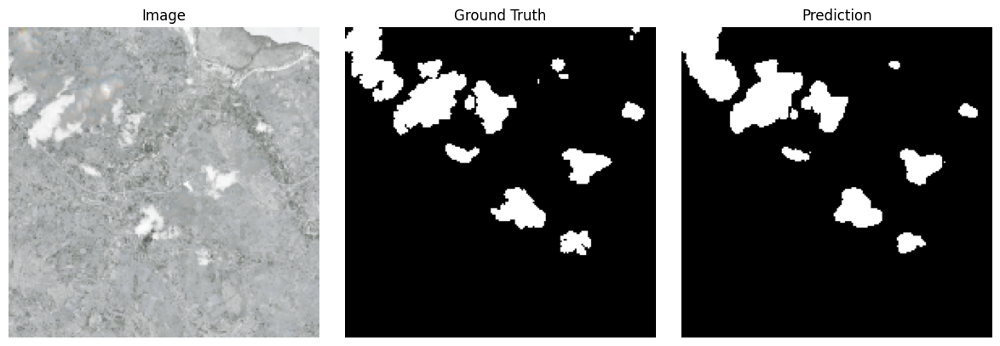

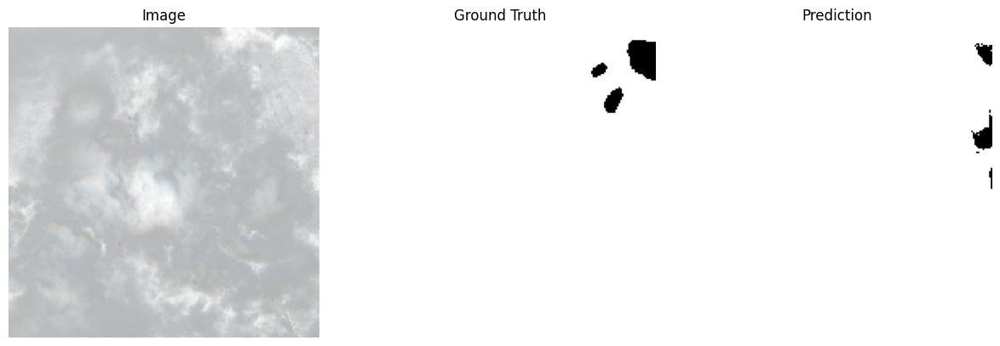

100%|██████████| 47/47 [00:11<00:00,  4.18it/s]


Epoch 71 | Learning rate: 0.000084
Epoch [71/100], Train Loss: 0.1277, Val Loss: 0.1266, Val Bloss: 0.1465, Val Dloss: 0.0803, Val mIoU: 0.8365


100%|██████████| 47/47 [00:11<00:00,  4.14it/s]


Epoch 72 | Learning rate: 0.000084
Epoch [72/100], Train Loss: 0.1289, Val Loss: 0.1270, Val Bloss: 0.1475, Val Dloss: 0.0793, Val mIoU: 0.8418


100%|██████████| 47/47 [00:12<00:00,  3.86it/s]


Epoch 73 | Learning rate: 0.000084
Epoch [73/100], Train Loss: 0.1270, Val Loss: 0.1277, Val Bloss: 0.1484, Val Dloss: 0.0795, Val mIoU: 0.8423


100%|██████████| 47/47 [00:11<00:00,  4.00it/s]


Epoch 74 | Learning rate: 0.000084
Epoch [74/100], Train Loss: 0.1290, Val Loss: 0.1260, Val Bloss: 0.1461, Val Dloss: 0.0793, Val mIoU: 0.8421
Best model saved at epoch 74


100%|██████████| 47/47 [00:11<00:00,  4.05it/s]


Epoch 75 | Learning rate: 0.000084
Epoch [75/100], Train Loss: 0.1285, Val Loss: 0.1276, Val Bloss: 0.1476, Val Dloss: 0.0810, Val mIoU: 0.8338


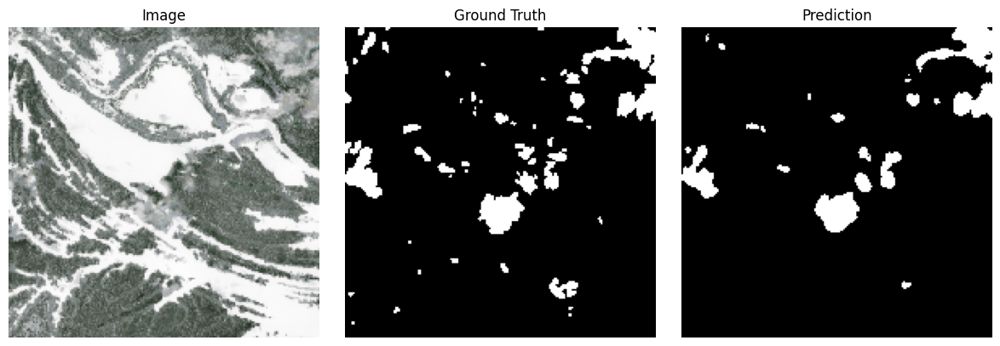

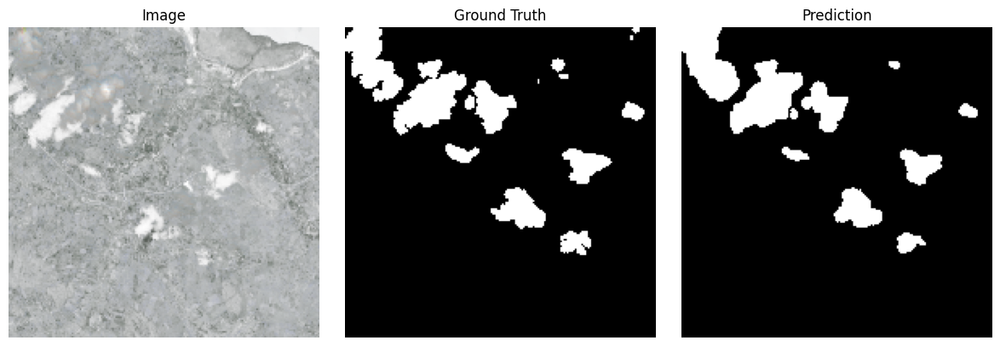

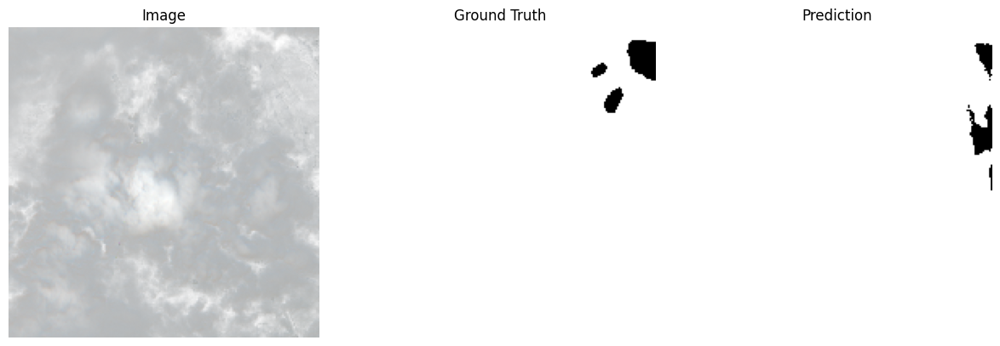

100%|██████████| 47/47 [00:11<00:00,  4.10it/s]


Epoch 76 | Learning rate: 0.000084
Epoch [76/100], Train Loss: 0.1278, Val Loss: 0.1256, Val Bloss: 0.1460, Val Dloss: 0.0781, Val mIoU: 0.8416
Best model saved at epoch 76


100%|██████████| 47/47 [00:11<00:00,  4.17it/s]


Epoch 77 | Learning rate: 0.000084
Epoch [77/100], Train Loss: 0.1277, Val Loss: 0.1267, Val Bloss: 0.1473, Val Dloss: 0.0785, Val mIoU: 0.8411


100%|██████████| 47/47 [00:12<00:00,  3.91it/s]


Epoch 78 | Learning rate: 0.000084
Epoch [78/100], Train Loss: 0.1270, Val Loss: 0.1283, Val Bloss: 0.1496, Val Dloss: 0.0788, Val mIoU: 0.8399


100%|██████████| 47/47 [00:11<00:00,  3.94it/s]


Epoch 79 | Learning rate: 0.000084
Epoch [79/100], Train Loss: 0.1273, Val Loss: 0.1268, Val Bloss: 0.1473, Val Dloss: 0.0791, Val mIoU: 0.8410


100%|██████████| 47/47 [00:12<00:00,  3.88it/s]


Epoch 80 | Learning rate: 0.000084
Epoch [80/100], Train Loss: 0.1277, Val Loss: 0.1263, Val Bloss: 0.1471, Val Dloss: 0.0778, Val mIoU: 0.8401


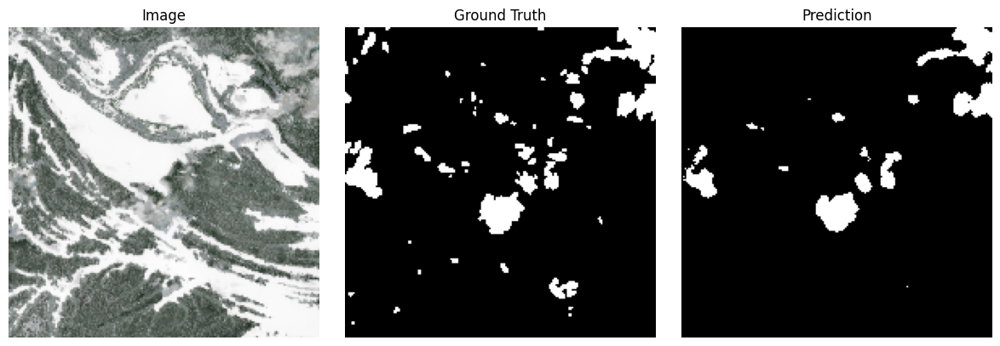

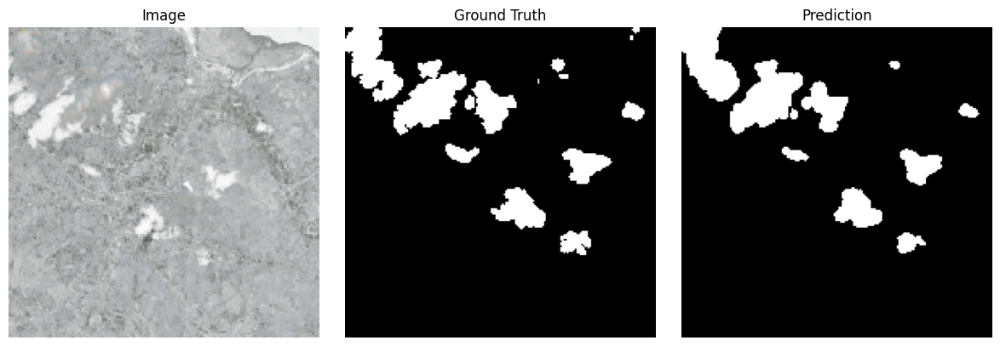

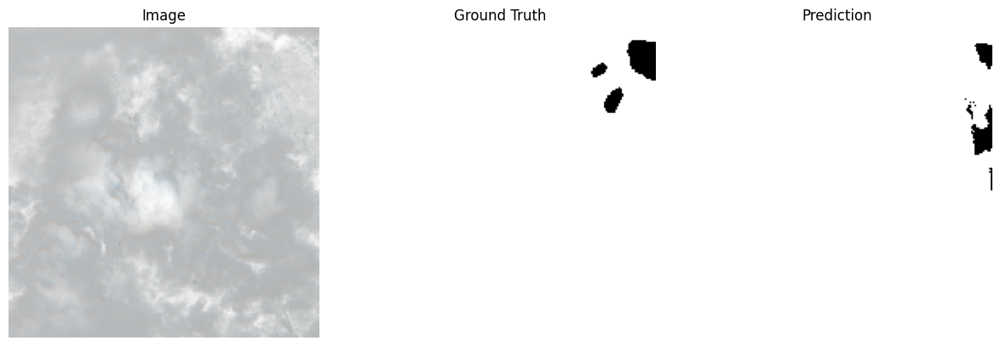

100%|██████████| 47/47 [00:12<00:00,  3.83it/s]


Epoch 81 | Learning rate: 0.000084
Epoch [81/100], Train Loss: 0.1272, Val Loss: 0.1274, Val Bloss: 0.1488, Val Dloss: 0.0776, Val mIoU: 0.8402


100%|██████████| 47/47 [00:11<00:00,  3.93it/s]


Epoch 82 | Learning rate: 0.000059
Epoch [82/100], Train Loss: 0.1275, Val Loss: 0.1282, Val Bloss: 0.1491, Val Dloss: 0.0794, Val mIoU: 0.8400


100%|██████████| 47/47 [00:12<00:00,  3.75it/s]


Epoch 83 | Learning rate: 0.000059
Epoch [83/100], Train Loss: 0.1262, Val Loss: 0.1276, Val Bloss: 0.1487, Val Dloss: 0.0784, Val mIoU: 0.8429


100%|██████████| 47/47 [00:11<00:00,  4.03it/s]


Epoch 84 | Learning rate: 0.000059
Epoch [84/100], Train Loss: 0.1269, Val Loss: 0.1274, Val Bloss: 0.1477, Val Dloss: 0.0801, Val mIoU: 0.8429


100%|██████████| 47/47 [00:12<00:00,  3.90it/s]


Epoch 85 | Learning rate: 0.000059
Epoch [85/100], Train Loss: 0.1267, Val Loss: 0.1272, Val Bloss: 0.1477, Val Dloss: 0.0792, Val mIoU: 0.8431


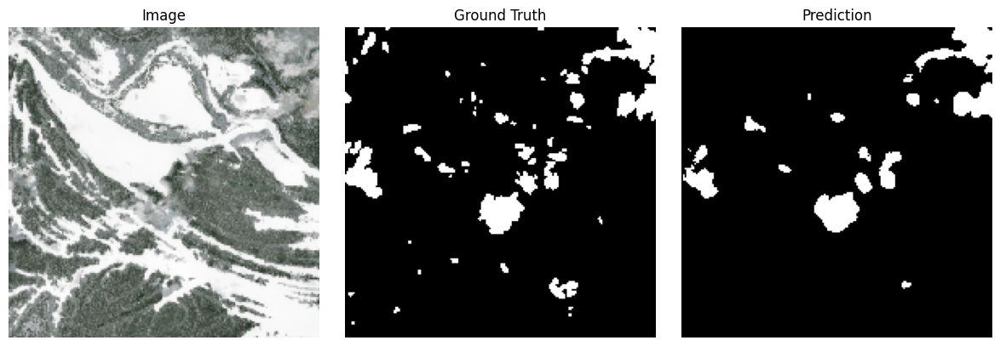

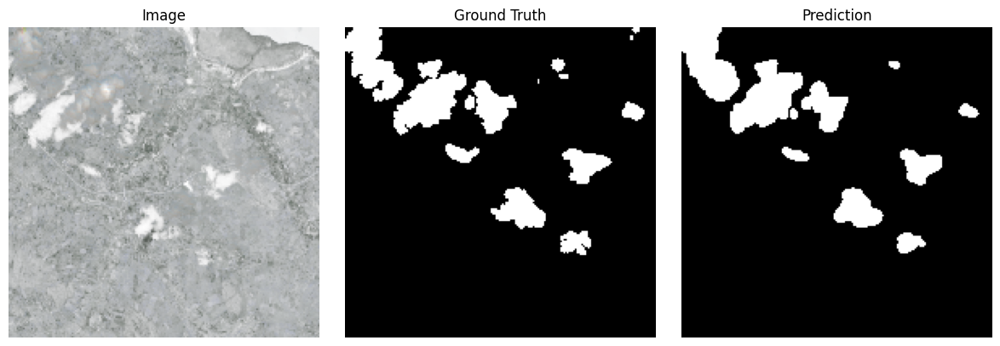

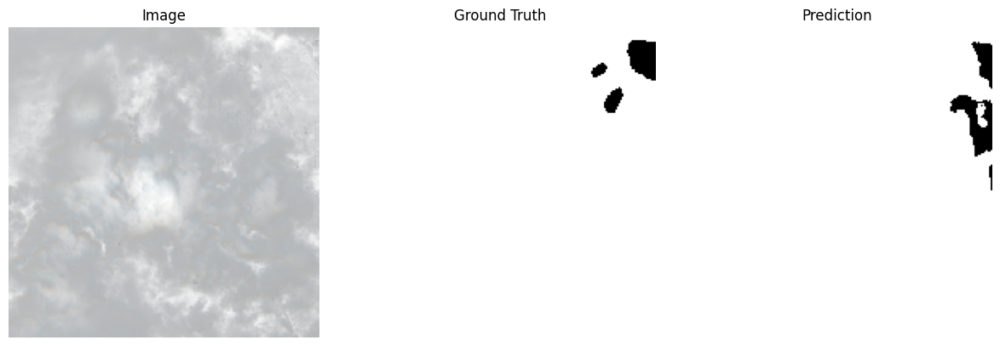

100%|██████████| 47/47 [00:11<00:00,  4.03it/s]


Epoch 86 | Learning rate: 0.000059
Epoch [86/100], Train Loss: 0.1269, Val Loss: 0.1262, Val Bloss: 0.1469, Val Dloss: 0.0778, Val mIoU: 0.8408


100%|██████████| 47/47 [00:11<00:00,  3.92it/s]


Epoch 87 | Learning rate: 0.000059
Epoch [87/100], Train Loss: 0.1266, Val Loss: 0.1272, Val Bloss: 0.1480, Val Dloss: 0.0785, Val mIoU: 0.8414


100%|██████████| 47/47 [00:11<00:00,  4.07it/s]


Epoch 88 | Learning rate: 0.000041
Epoch [88/100], Train Loss: 0.1264, Val Loss: 0.1264, Val Bloss: 0.1462, Val Dloss: 0.0801, Val mIoU: 0.8375


100%|██████████| 47/47 [00:11<00:00,  4.09it/s]


Epoch 89 | Learning rate: 0.000041
Epoch [89/100], Train Loss: 0.1249, Val Loss: 0.1254, Val Bloss: 0.1462, Val Dloss: 0.0769, Val mIoU: 0.8419
Best model saved at epoch 89


100%|██████████| 47/47 [00:11<00:00,  4.01it/s]


Epoch 90 | Learning rate: 0.000041
Epoch [90/100], Train Loss: 0.1248, Val Loss: 0.1262, Val Bloss: 0.1463, Val Dloss: 0.0792, Val mIoU: 0.8448


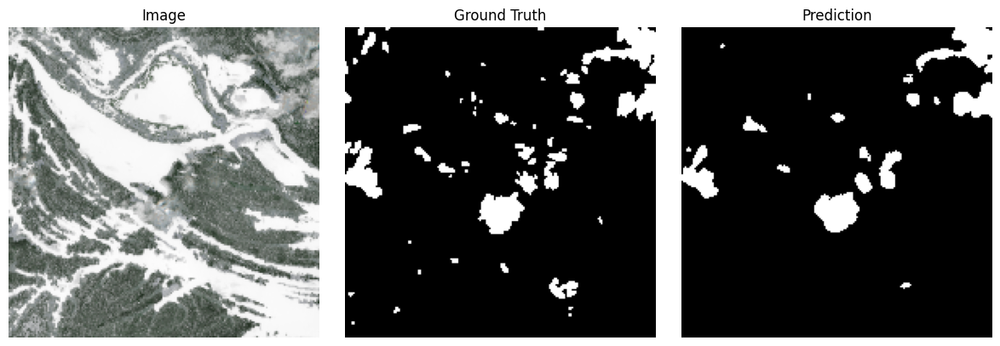

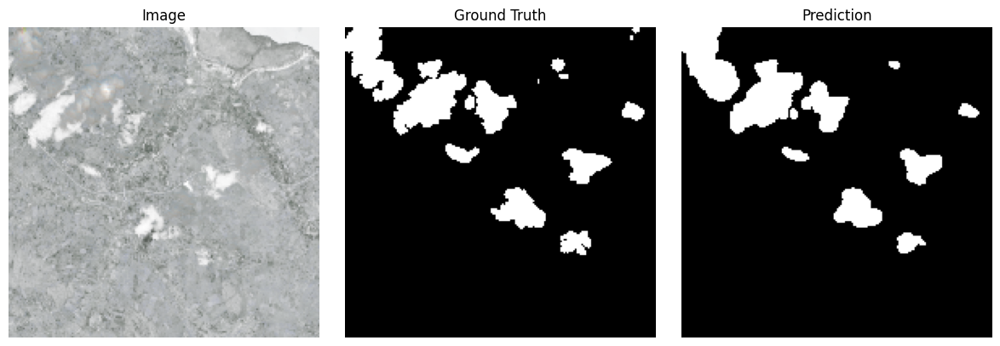

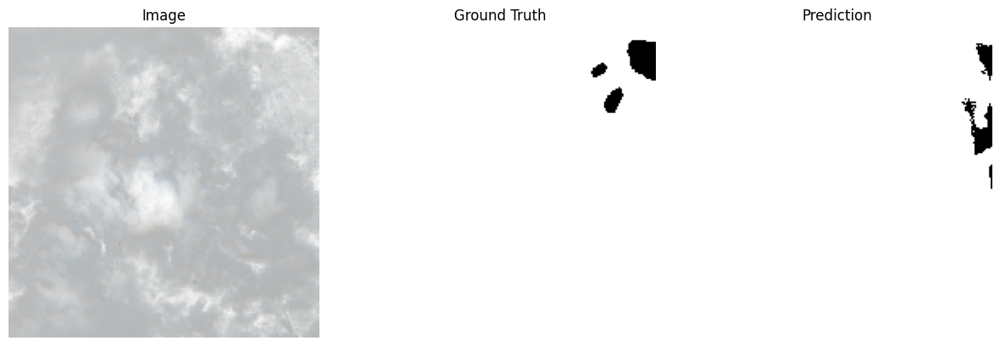

100%|██████████| 47/47 [00:11<00:00,  4.07it/s]


Epoch 91 | Learning rate: 0.000041
Epoch [91/100], Train Loss: 0.1236, Val Loss: 0.1284, Val Bloss: 0.1496, Val Dloss: 0.0789, Val mIoU: 0.8437


100%|██████████| 47/47 [00:11<00:00,  4.16it/s]


Epoch 92 | Learning rate: 0.000041
Epoch [92/100], Train Loss: 0.1256, Val Loss: 0.1254, Val Bloss: 0.1463, Val Dloss: 0.0766, Val mIoU: 0.8426


100%|██████████| 47/47 [00:11<00:00,  4.10it/s]


Epoch 93 | Learning rate: 0.000041
Epoch [93/100], Train Loss: 0.1262, Val Loss: 0.1285, Val Bloss: 0.1498, Val Dloss: 0.0787, Val mIoU: 0.8428


100%|██████████| 47/47 [00:11<00:00,  3.97it/s]


Epoch 94 | Learning rate: 0.000041
Epoch [94/100], Train Loss: 0.1240, Val Loss: 0.1265, Val Bloss: 0.1468, Val Dloss: 0.0790, Val mIoU: 0.8417


100%|██████████| 47/47 [00:11<00:00,  3.97it/s]


Epoch 95 | Learning rate: 0.000029
Epoch [95/100], Train Loss: 0.1250, Val Loss: 0.1262, Val Bloss: 0.1468, Val Dloss: 0.0783, Val mIoU: 0.8408


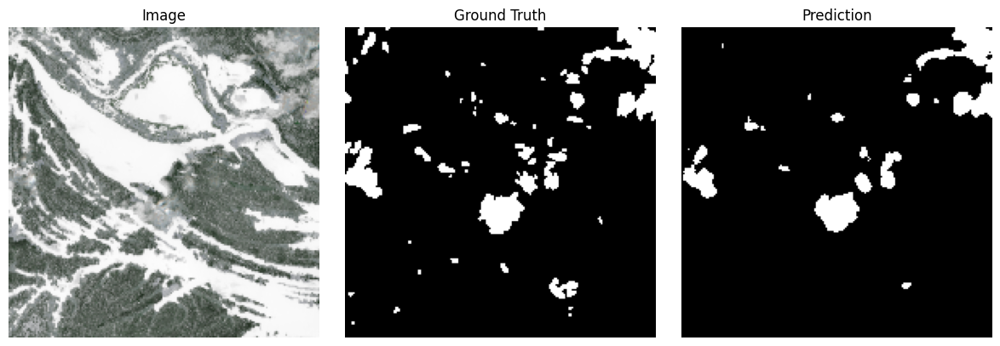

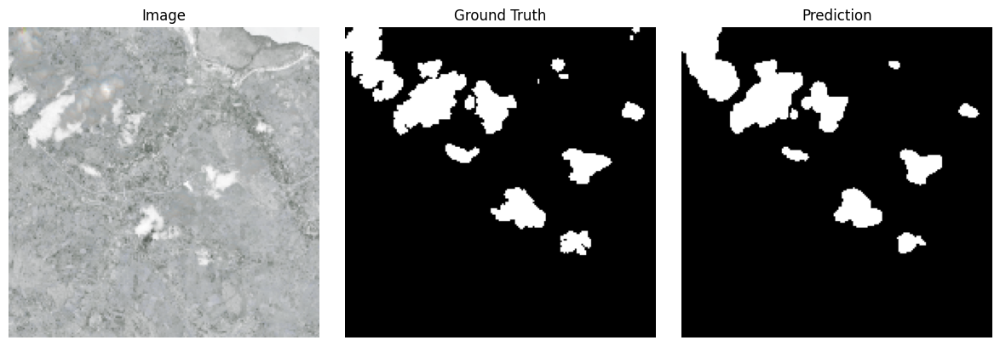

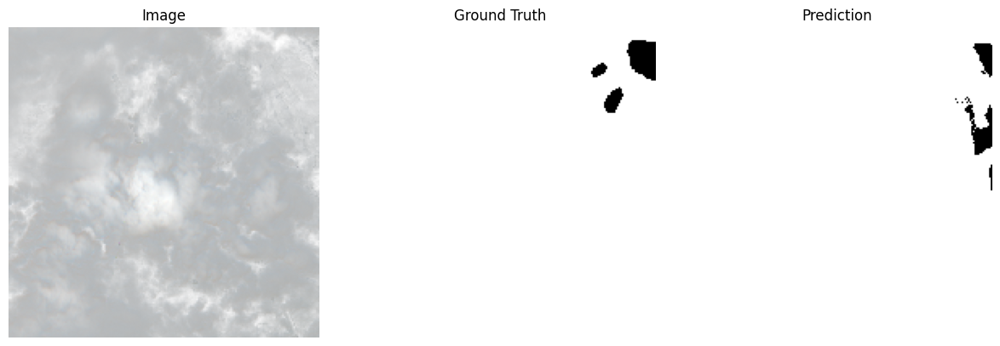

100%|██████████| 47/47 [00:11<00:00,  4.03it/s]


Epoch 96 | Learning rate: 0.000029
Epoch [96/100], Train Loss: 0.1238, Val Loss: 0.1269, Val Bloss: 0.1472, Val Dloss: 0.0795, Val mIoU: 0.8431


100%|██████████| 47/47 [00:11<00:00,  3.95it/s]


Epoch 97 | Learning rate: 0.000029
Epoch [97/100], Train Loss: 0.1249, Val Loss: 0.1282, Val Bloss: 0.1494, Val Dloss: 0.0786, Val mIoU: 0.8423


100%|██████████| 47/47 [00:11<00:00,  3.94it/s]


Epoch 98 | Learning rate: 0.000029
Epoch [98/100], Train Loss: 0.1241, Val Loss: 0.1266, Val Bloss: 0.1473, Val Dloss: 0.0785, Val mIoU: 0.8421


100%|██████████| 47/47 [00:11<00:00,  4.09it/s]


Epoch 99 | Learning rate: 0.000029
Epoch [99/100], Train Loss: 0.1268, Val Loss: 0.1272, Val Bloss: 0.1478, Val Dloss: 0.0790, Val mIoU: 0.8426


100%|██████████| 47/47 [00:11<00:00,  4.19it/s]


Epoch 100 | Learning rate: 0.000029
Epoch [100/100], Train Loss: 0.1227, Val Loss: 0.1256, Val Bloss: 0.1461, Val Dloss: 0.0777, Val mIoU: 0.8421


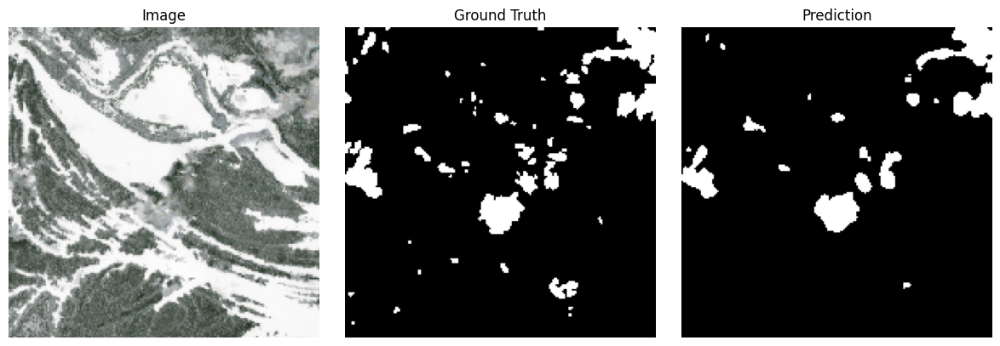

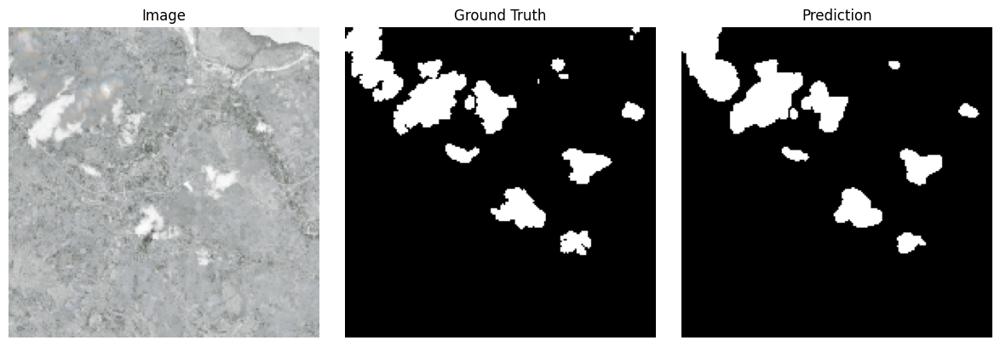

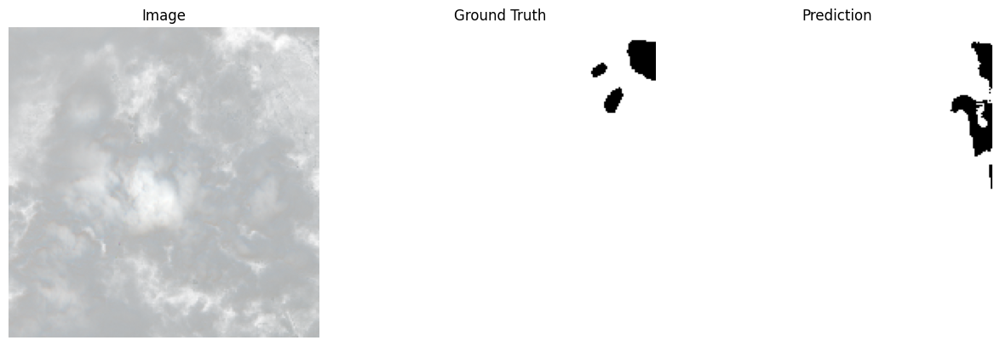

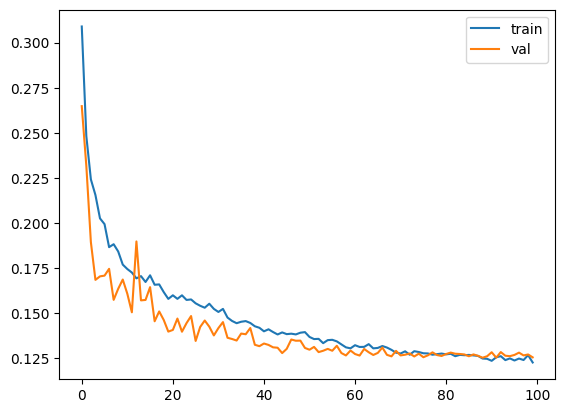

In [14]:
from tqdm import tqdm

num_epochs = 100
best_loss = float('inf')
train_losses = []
val_losses = []
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0
    for images, masks in tqdm(train_loader):
        images = images.to(device)
        masks = masks.to(device).unsqueeze(1).float()
        optimizer.zero_grad()
        outputs = model(images)
        loss = 0.7 * bce_loss(outputs, masks) + 0.3 * dice_loss(outputs, masks)
        epoch_loss += loss.item()
        loss.backward()
        optimizer.step()

    epoch_loss /= len(train_loader)
    train_losses.append(epoch_loss)

    model.eval()
    val_mIoU = 0.0
    with torch.no_grad():
        val_loss = 0.0
        val_bloss = 0.0
        val_dloss = 0.0
        for images, masks in tqdm(val_loader):
            images = images.to(device)
            masks = masks.to(device).unsqueeze(1).float()
            outputs = model(images)
            bloss = bce_loss(outputs, masks)
            dloss = dice_loss(outputs, masks)
            loss = 0.7 * bloss + 0.3 * dloss
            val_loss += loss.item()
            val_bloss += bloss.item()
            val_dloss += dloss.item()
            val_mIoU += compute_iou(outputs, masks)

    val_loss /= len(val_loader)
    val_bloss /= len(val_loader)
    val_dloss /= len(val_loader)
    val_mIoU /= len(val_loader)
    val_losses.append(val_loss)
    scheduler.step(val_loss)

    for param_group in optimizer.param_groups:
        print(f"Epoch {epoch+1} | Learning rate: {param_group['lr']:.6f}")

    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {epoch_loss:.4f}, Val Loss: {val_loss:.4f}, Val Bloss: {val_bloss:.4f}, Val Dloss: {val_dloss:.4f}, Val mIoU: {val_mIoU:.4f}')

    if (epoch + 1) % 5 == 0:
        visualize_predictions(model, val_loader, device, num_samples=3)
    
    if val_loss < best_loss:
        best_loss = val_loss
        torch.save(model.state_dict(), "best.pth")
        print(f"Best model saved at epoch {epoch+1}")

plt.plot(train_losses, label='train')
plt.plot(val_losses, label='val')
plt.legend()
plt.show()